# Self-Driving Car Nanodegree

## Project 4: Advanced Lane Finding

Miguel Morales | [@mimoralea](https://twitter.com/mimoralea) | [mimoralea@gmail.com](mailto:mimoralea@gmail.com)

In this project, we used advanced Computer Vision techniques to find road lane lines on images and video streams. First, we calibrated the camera obtaining the camera matrix and distortion coefficients. Then we created a pipeline of advanced methods to correctly identify lane line pixels, and finally applied these methods to video streams using confidence levels to detect and track the lines through the video.

These are the imports we'll be using throughout this notebook:

In [1]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML
from ipywidgets import (widgets, interactive, FloatSlider, IntSlider, \
                        IntRangeSlider, FloatRangeSlider, RadioButtons)
from scipy.misc import imread, imresize
from scipy.signal import find_peaks_cwt
from sklearn.preprocessing import normalize
from sklearn import datasets, linear_model
import numpy.polynomial.polynomial as poly

import numpy as np
import cv2
import pylab
import matplotlib.pyplot as plt
import glob

**NOTE:** The full class is int the notebook `solution.ipynb` named `VideoProcessing`.

These are a couple of helper functions for plotting images:

In [2]:
def plot_imgs(imgs, titles=None):
    fig = plt.figure(figsize=(20,50))
    for i in range(len(imgs)):
        img = imgs[i]

        ax = fig.add_subplot(9, 3, i + 1)
        ax.grid(False)
        ax.get_xaxis().set_ticks([])
        ax.get_yaxis().set_ticks([])
        ax.imshow(img, cmap='gray')
        if titles != None:
            ax.set_title(titles[i], fontsize=50)
    plt.show()

def plot_side_by_side(img1, title1, img2, title2):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img1, cmap='gray')
    ax1.set_title(title1, fontsize=50)
    ax2.imshow(img2, cmap='gray')
    ax2.set_title(title2, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

# Camera Calibration

**1. Briefly state how you computed the camera matrix and distortion coefficients. Provide an example of a distortion corrected calibration image.**

The following functions are used to get the camera matrix, distortion coefficients, calibrate the camera and get the images:

In [3]:
def get_calibration_coef(cal_imgs, nx=9, ny=6, plot=False):
    objpoints = []
    imgpoints = []
    drawnimgs = []

    objp = np.zeros((nx*ny, 3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)

    fnames = glob.glob(cal_imgs)

    for fname in fnames:
        img = imread(fname)

        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

        # if chessboard corners were not found, continue to next image
        if not ret:
            continue

        # save the points to calibrate later
        imgpoints.append(corners)
        objpoints.append(objp)

        # no need to waste cycles if do not want plotting
        if not plot:
            continue

        # draw points in the img and save a copy
        cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
        drawnimgs.append(img)
    return objpoints, imgpoints, drawnimgs

def calibrate(img_shape, objpoints, imgpoints):
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(
        objpoints, imgpoints, img_shape, None, None)
    return mtx, dist

def undistort(img, mtx, dist):
    return cv2.undistort(img, mtx, dist, None, mtx)

def cal_undistort(img, objpoints, imgpoints, mtx=None, dist=None):

    if mtx==None or dist==None:
        mtx, dist = calibrate(img.shape[0:2], objpoints, imgpoints)

    undist = undistort(img, mtx, dist)
    return undist, mtx, dist

We obtain the coefficients:

In [4]:
udobjpoints, udimgpoints, udimgs = get_calibration_coef('ud_cal/calibration*.jpg', plot=True)

Here is a sample of the images that serve to calibrate:

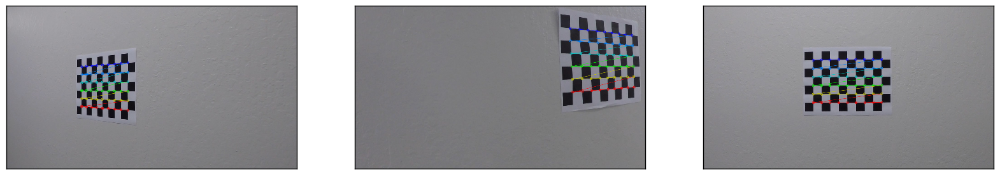

In [5]:
plot_imgs(udimgs[0:3])

This is a sample of a undistorted image:

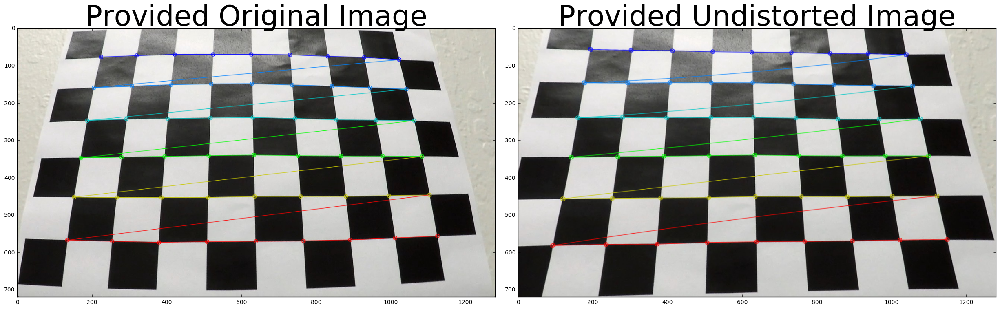

In [6]:
udimg = udimgs[10]
udundistorted, udmtx, uddist = cal_undistort(udimg, udobjpoints, udimgpoints)
plot_side_by_side(udimg, 'Provided Original Image', udundistorted, 'Provided Undistorted Image')

# Pipeline (single images)

**1. Provide an example of a distortion-corrected image.**

The following is the code use to correct distorted images:

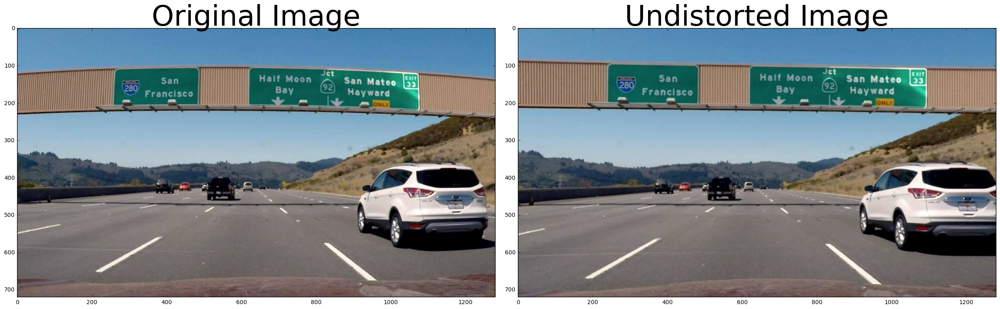

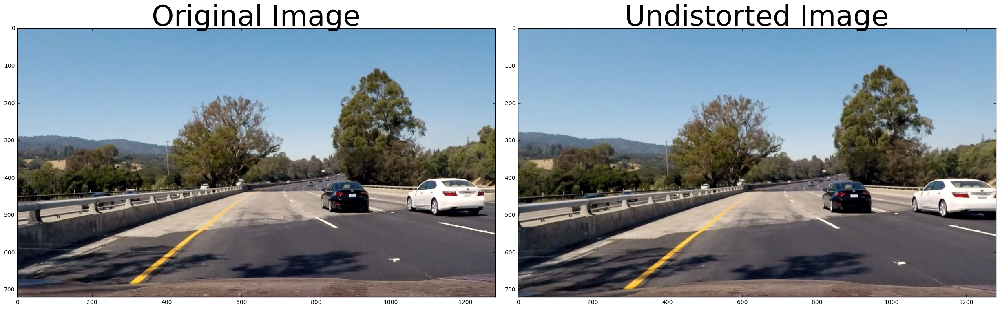

In [7]:
udimg1 = imread('ud_images/signs_vehicles_xygrad.jpg')
udimg2 = imread('ud_images/test4.jpg')

und1 = undistort(udimg1, udmtx, uddist)
und2 = undistort(udimg2, udmtx, uddist)

plot_side_by_side(udimg1, 'Original Image', und1, 'Undistorted Image')
plot_side_by_side(udimg2, 'Original Image', und2, 'Undistorted Image')

**2. Describe how (and identify where in your code) you performed a perspective transform and provide an example of a transformed image.**

As you may noticed, I performed perspective transform before obtaining binary images. This proved to give me better results. Firs these are the functions used to perform the transform:

In [8]:
def unwarp(img, mtx, dist):
    img_size = (img.shape[1], img.shape[0])    
    x, y = img_size

    src = np.float32([
            (180, 680), (595, 440), (685, 440), (1280, 680),
        ])    
    dst = np.float32([
            (530, 720), (530, 0), (760, 0), (760, 720)
        ])

    unwarpped, M = corners_unwarp(img, mtx, dist, src, dst)
    return unwarpped, M

def get_perspective(img_size, src=None, dst=None, inv=False):
    x, y = img_size

    if src == None or dst == None:
        src = np.float32([
                (180, 680), (595, 440), (685, 440), (1280, 680),
            ])    
        dst = np.float32([
                (530, 720), (530, 0), (760, 0), (760, 720)
            ])

    return cv2.getPerspectiveTransform(src, dst) if not inv else cv2.getPerspectiveTransform(dst, src)

def corners_unwarp(img, mtx, dist, src=None, dst=None):
    img_size = (img.shape[1], img.shape[0])
    M = get_perspective(img_size, src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags = cv2.INTER_LINEAR)
    return warped, M

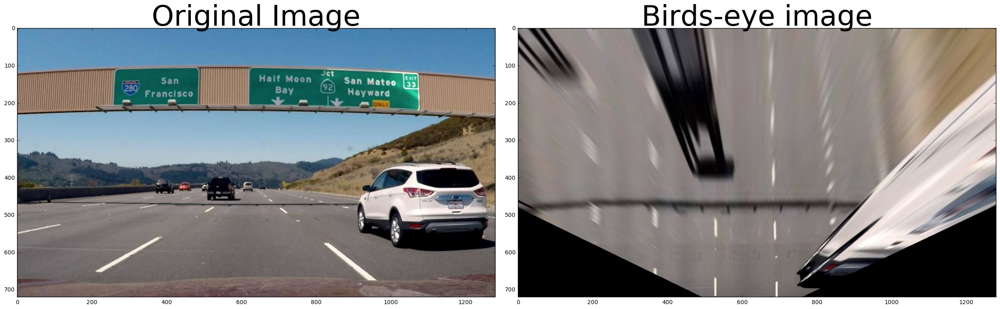

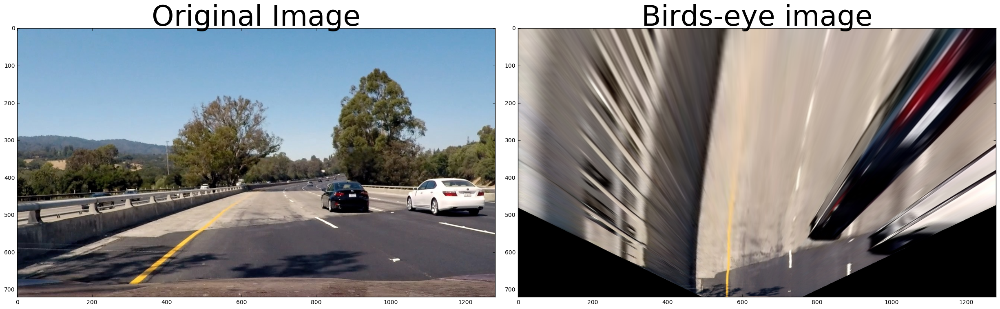

In [9]:
org = udimg1
und = undistort(org, udmtx, uddist)
warp, M = unwarp(und, udmtx, uddist)
plot_side_by_side(org, 'Original Image', warp, 'Birds-eye image')

org = udimg2
und = undistort(org, udmtx, uddist)
warp, M = unwarp(und, udmtx, uddist)
plot_side_by_side(org, 'Original Image', warp, 'Birds-eye image')

** 3. Describe how (and identify where in your code) you used color transforms, gradients or other methods to create a thresholded binary image. Provide an example of a binary image result.**

First, let's add the functions that will help us get this done:

In [10]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):

    gray = img

    # 1) Convert to grayscale
    if len(img.shape) == 3:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    sobel = sobelx if orient == 'x' else sobely

    # 3) Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)

    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scale_factor = np.max(abs_sobel)/255 
    scaled_sobel = (abs_sobel/scale_factor).astype(np.uint8) 

    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    binary = np.zeros_like(scaled_sobel)
    binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    # 6) Return this mask as your binary_output image
    return binary

def hls_select(img, selection='l', thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    
    # 2) Apply a threshold to the S channel
    q = H if selection=='h' else L if selection=='l' else S
    binary = np.zeros_like(q)
    binary[(q > thresh[0]) & (q <= thresh[1])] = 1
    
    return binary

def filter_yellow(img):
    img = cv2.GaussianBlur(img, (1, 1), 0)
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    mask = cv2.inRange(hsv, 
                       (10, 80, 170), 
                       (40, 225, 225))
    return mask

def filter_white(img):
    mask = cv2.inRange(img, 
                       (165, 165, 175), 
                       (255, 255, 255))
    return mask

def detect_binary_lines(img):
    s = hls_select(img, selection='s', thresh=(100, 255))
    g = abs_sobel_thresh(s, orient='x', sobel_kernel=3, thresh=(80, 255))

    y = filter_yellow(img)
    w = filter_white(img)
    return np.array((y | w | g), dtype=np.uint8)

Next, notice that I utilize a two binary algorithm. One binary image is more restrictive and therefore produces cleaner lines. However, it also misses images in some occasions. Therefore, the second image helps if we need are not able to find the line in the first binary image.

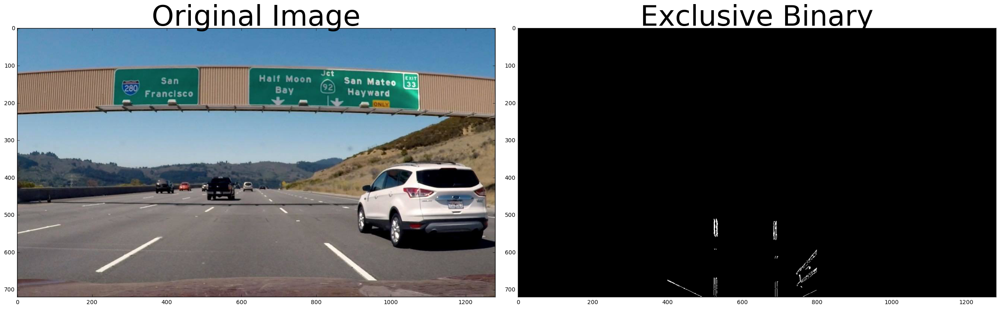

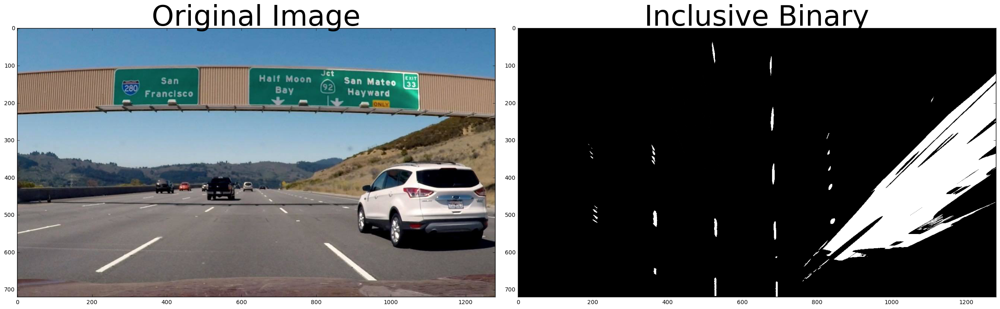

In [11]:
org = udimg1
und = undistort(org, udmtx, uddist)
warp, M = unwarp(und, udmtx, uddist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))
binary = detect_binary_lines(warp)

y, x = warp.shape[:2]
sx[:,:400] = 0
sx[:,800:] = 0
sx[:500,:] = 0

plot_side_by_side(org, 'Original Image', sx, 'Exclusive Binary')
plot_side_by_side(org, 'Original Image', binary, 'Inclusive Binary')

**4. Describe how (and identify where in your code) you identified lane-line pixels and fit their positions with a polynomial?**

The clean image allows for an easier and more robust detection of the initial lane line, while the second allows for the full detection of the whole thing. The code was divided into two parts, one to detect the vertical axis in which to look for lines, and the second to actually look for the lines. The code looks as follows:

In [12]:
def get_peaks(img, middle, plot=True):
    histogram = np.sum(img[600:,:], axis=0)
    histogram[histogram < 15] = 0
    peaks = np.array(find_peaks_cwt(histogram, np.arange(15, 30)))

    lefts = np.sort(peaks[peaks < middle])[::-1]
    rights = np.sort(peaks[peaks > middle])

    possible_pairs = []
    dist = (155, 185)
    for left in lefts:
        lowest = left + dist[0]
        highest = left + dist[1]
        subset_possible = peaks[peaks > lowest]
        subset_possible = subset_possible[subset_possible < highest]
        if len(subset_possible) > 0:
            # get first possible
            possible_pairs.append((left, subset_possible[0]))
  
    if plot:
        f, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 15))
        f.tight_layout()
        ax1.imshow(img, cmap='gray')
        plt.setp(ax1.get_xticklabels(), visible=False)
        ax2 = plt.subplot(212, sharex=ax1)
        plt.plot(histogram)
        plt.show()

    return possible_pairs

As you will see, this function finds the peaks in a histogram and it purges some possible outliers. Now, in the final version we use median values instead, however, this is roughly how it looks:

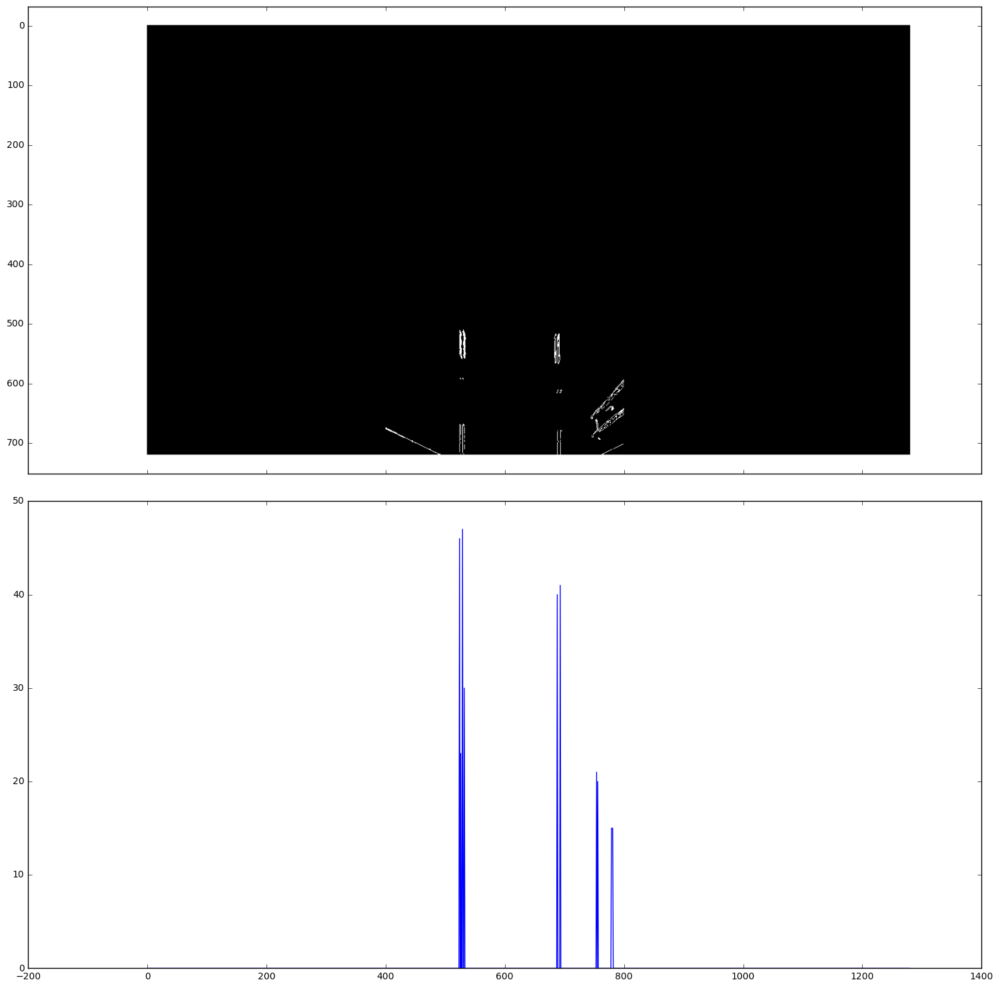

[(528, 691)]


In [13]:
pairs = get_peaks(sx, x//2)
print(pairs)

Next, we use a adjustable moving window technique to look for the line across the y axis. Let's add a function to show this: 

In [14]:
def get_window_values(img, starty, endy, startx, endx, 
                      thresh=(0.2, 5, 10)):
    
    window_img = img[starty:endy,startx:endx]
    hist = np.sum(window_img, axis=0)
    hist = hist / np.linalg.norm(hist)
    hist[hist < thresh[0]] = 0
    peaks = np.array(find_peaks_cwt(hist, np.arange(
                thresh[1], thresh[2])))
    return window_img, hist, peaks

def get_peak_displacement(x, my_peaks, other_peaks):
    
    if len(my_peaks) == 0 and len(other_peaks) == 1:
        return other_peaks[0]
    if len(my_peaks) > 0:
        idx = (np.abs(my_peaks-x)).argmin()
        return my_peaks[idx]
    return x

def draw_window_outline(img, window_left_x, window_right_x, 
                        bottom_y, upper_y, col=((255,)*3), 
                        thickness=2):
    cv2.line(img, (window_left_x, bottom_y), 
             (window_left_x, upper_y), col, thickness)
    cv2.line(img, (window_right_x, bottom_y), 
             (window_right_x, upper_y), col, thickness)
    cv2.line(img, (window_left_x, upper_y), 
             (window_right_x, upper_y), col, thickness)
    cv2.line(img, (window_left_x, bottom_y), 
             (window_right_x, bottom_y), col, thickness)
    return img


def clamp_values_to_lane_width(left_window_values, 
                               right_window_values, 
                               initial_lane_width):

    left_window_x, xl, wxl = left_window_values
    right_window_x, xr, wxr = right_window_values
    
    # calculate a default value
    new_wxl = left_window_x + xl
    new_wxr = right_window_x + xr

    new_lane_width = abs(new_wxr - new_wxl)
    lane_width_diff = abs(initial_lane_width - new_lane_width)
    if lane_width_diff >= 20:
        if abs(new_wxr - wxr) < abs(new_wxl - wxl):
            # inverse the values
            new_wxl = left_window_x + xr
        else:
            
            new_wxr = right_window_x + xl
    return new_wxl, new_wxr

def draw_middle_lines(img, left, right, bottom, top, 
                      color_left, color_right, thickness):

    cv2.line(img, (left, bottom), 
             (left, top), color_left, thickness)
    cv2.line(img, (right, bottom), 
             (right, top), color_right, thickness)
    return img


def draw_lane_lines(img, wxl, wxr, col, debug=False):
    dark = np.zeros_like(img).astype(np.uint8)
    color_dark = np.dstack((dark, dark, dark))

    bina = detect_binary_lines(col)
    bina[bina != 255] = 0
    bina[bina == 255] = 1

    y, x = img.shape
    wys, wxs = (100,100)
    lane_width = wxr - wxl
    
    centroids = []
    for wy in np.arange(y, 20, -100):
        # print(wy, wxl, ' -- ', wy, wxr)
        left_window_left_x, left_window_right_x = wxl-wxs//2, wxl+wxs//2
        right_window_left_x, right_window_right_x = wxr-wxs//2, wxr+wxs//2
        upper_y, bottom_y = (0 if wy == 120 else wy-wys), wy
        
        left_window_img, left_hist, left_peaks = get_window_values(
            img, upper_y, bottom_y, left_window_left_x, left_window_right_x)
        
        right_window_img, right_hist, right_peaks = get_window_values(
            img, upper_y, bottom_y, right_window_left_x, right_window_right_x)

        if len(left_peaks) == 0:
            left_window_img, left_hist, left_peaks = get_window_values(
                bina, upper_y, bottom_y, left_window_left_x, left_window_right_x)

        if len(right_peaks) == 0:
            right_window_img, right_hist, right_peaks = get_window_values(
                bina, upper_y, bottom_y, right_window_left_x, right_window_right_x)

        xl = get_peak_displacement(wxs//2, left_peaks, right_peaks)
        xr = get_peak_displacement(wxs//2, right_peaks, left_peaks)
        
        # drawing selected window images and histograms
        if debug:
            f, ((ax1, ax2),(ax3, ax4)) = plt.subplots(2, 2, figsize=(15, 15))
            f.tight_layout()
            ax1.imshow(left_window_img, cmap='gray')
            plt.setp(ax1.get_xticklabels(), visible=False)
            ax2.imshow(right_window_img, cmap='gray')
            plt.setp(ax2.get_xticklabels(), visible=False)
            ax3.plot(left_hist)
            ax4.plot(right_hist)
            plt.show()

        # draw left window
        draw_window_outline(color_dark, left_window_left_x, 
                            left_window_right_x, 
                            bottom_y, upper_y)

        draw_window_outline(col, left_window_left_x, 
                            left_window_right_x, 
                            bottom_y, upper_y)

        # draw right windows
        draw_window_outline(color_dark, right_window_left_x, 
                            right_window_right_x, 
                            bottom_y, upper_y)

        draw_window_outline(col, right_window_left_x, 
                            right_window_right_x, 
                            bottom_y, upper_y)

        new_wxl, new_wxr = clamp_values_to_lane_width(
            (left_window_left_x, xl, wxl), 
            (right_window_left_x, xr, wxr), 
            lane_width)

        color_left = (255,0,0) if len(left_peaks) == 0 else (0,255,0)
        color_right = (255,0,0) if len(right_peaks) == 0 else (0,255,0)
        draw_middle_lines(col, new_wxl, new_wxr, 
                          bottom_y, upper_y, color_left, color_right, 3)

        draw_middle_lines(color_dark, new_wxl, new_wxr, 
                          bottom_y, upper_y, color_left, color_right, 10)

        centroids.append((new_wxl, new_wxr, bottom_y))

        if len(centroids) < 5:
            # move windows over x axis
            wxl, wxr = new_wxl, new_wxr
        else:
            data = np.array(centroids)
            l = data[:,0]
            r = data[:,1]
            y = data[:,2]
            nwind = bottom_y - 100

            coefsl = poly.polyfit(y, l, 2)
            coefsr = poly.polyfit(y, r, 2)
            
            wxl = int(poly.polyval(nwind, coefsl))
            wxr = int(poly.polyval(nwind, coefsr))
    if debug:
        plot_imgs([img, bina, col])
    return [img, bina, col, color_dark], centroids

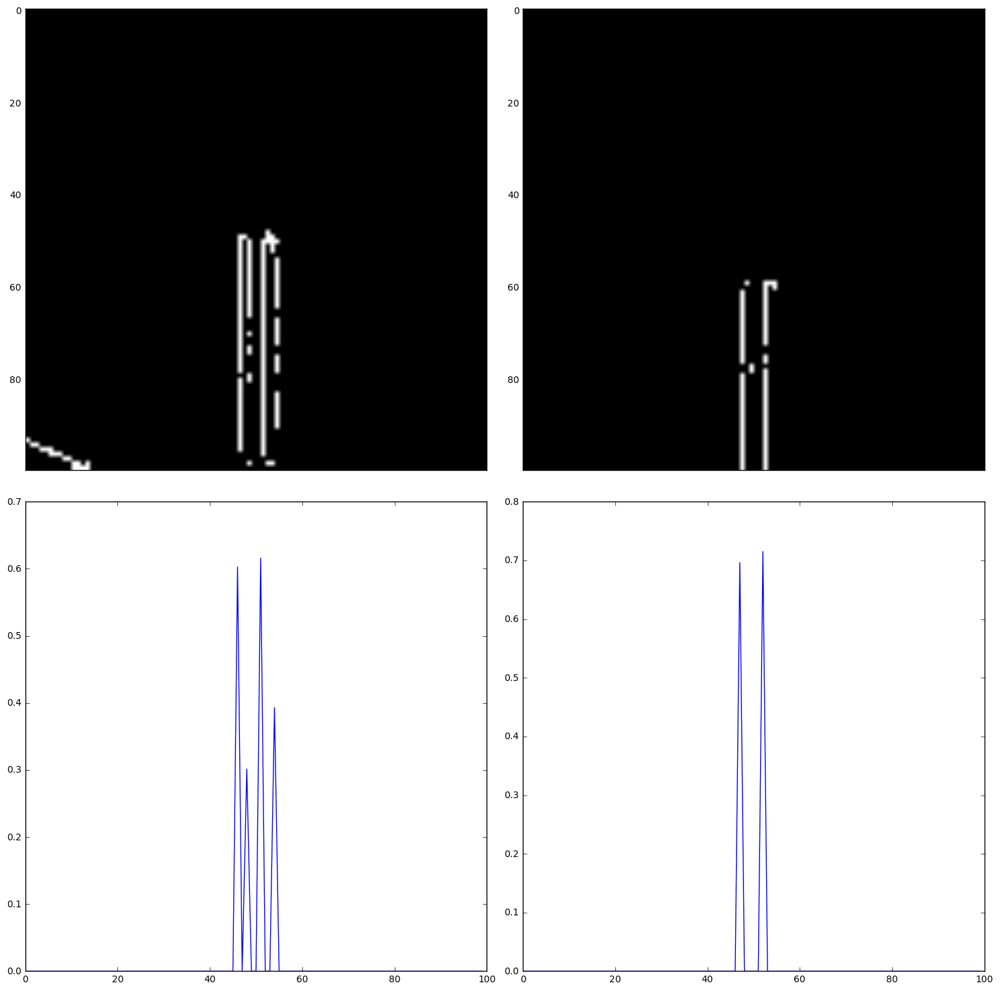

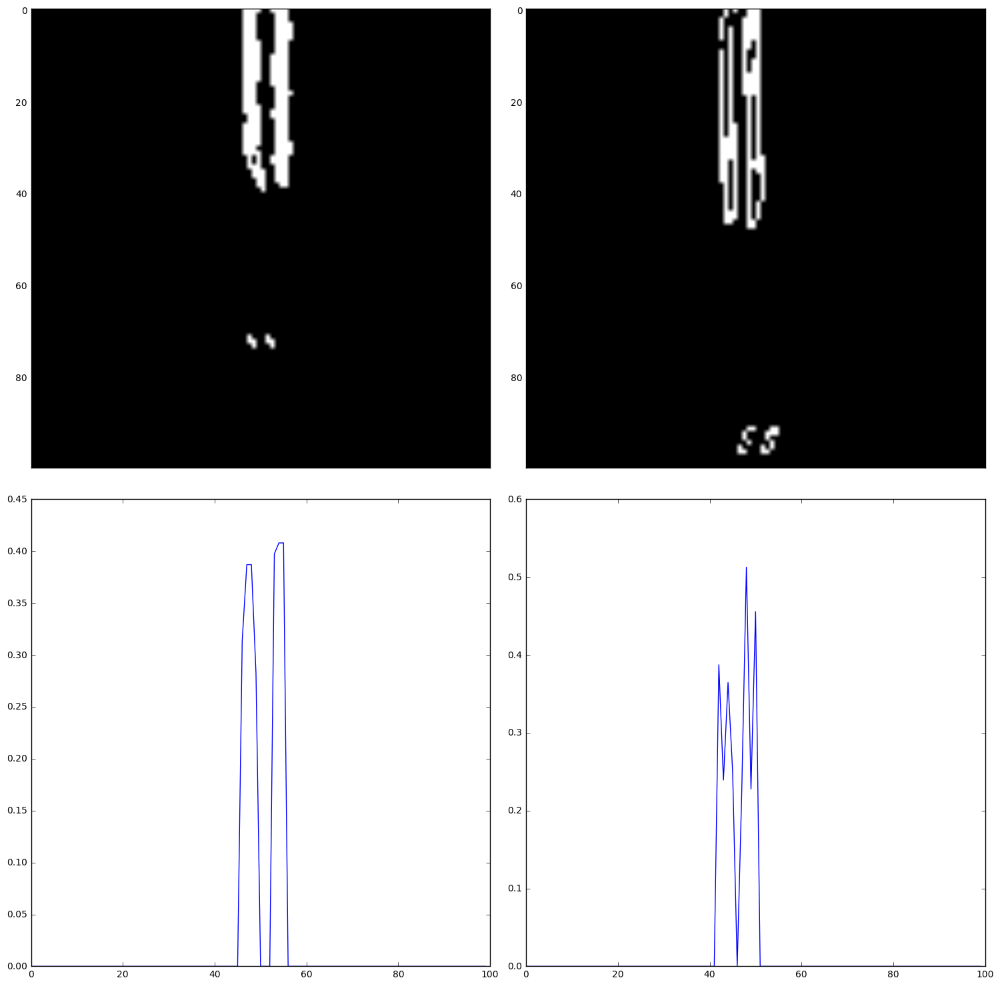

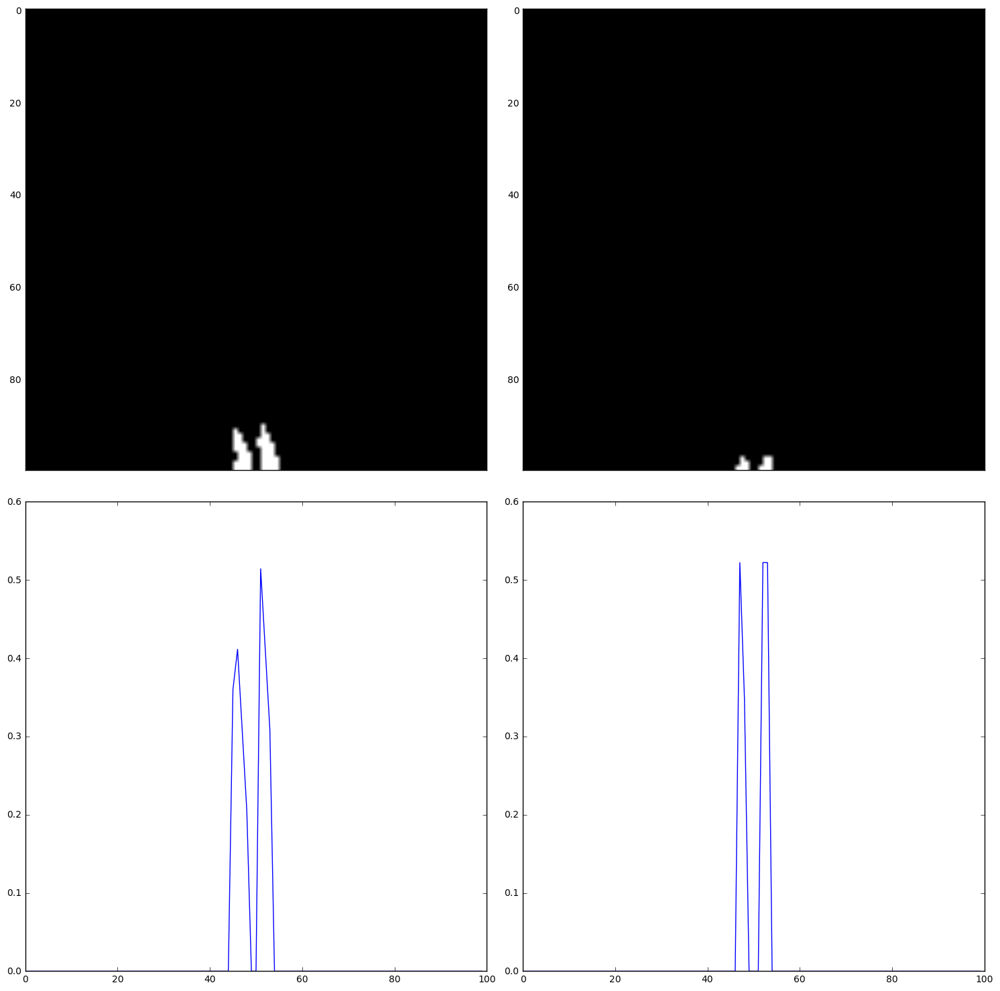

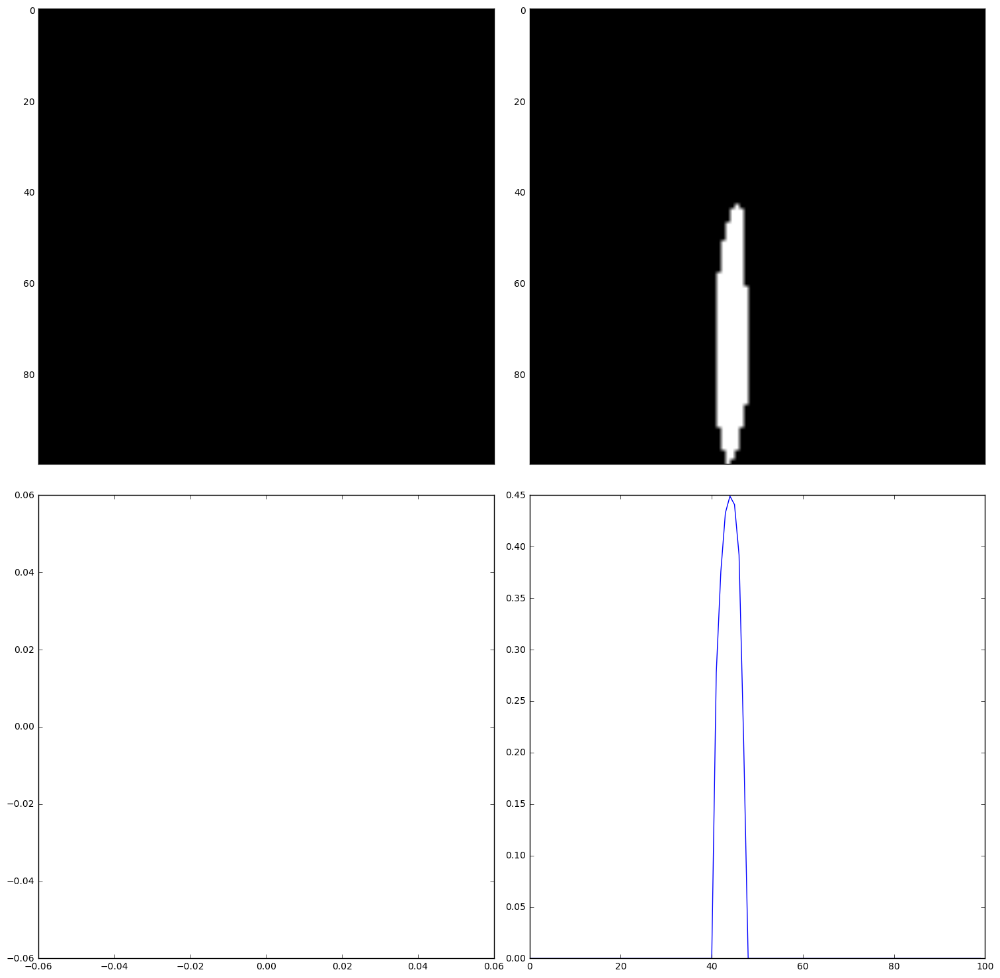

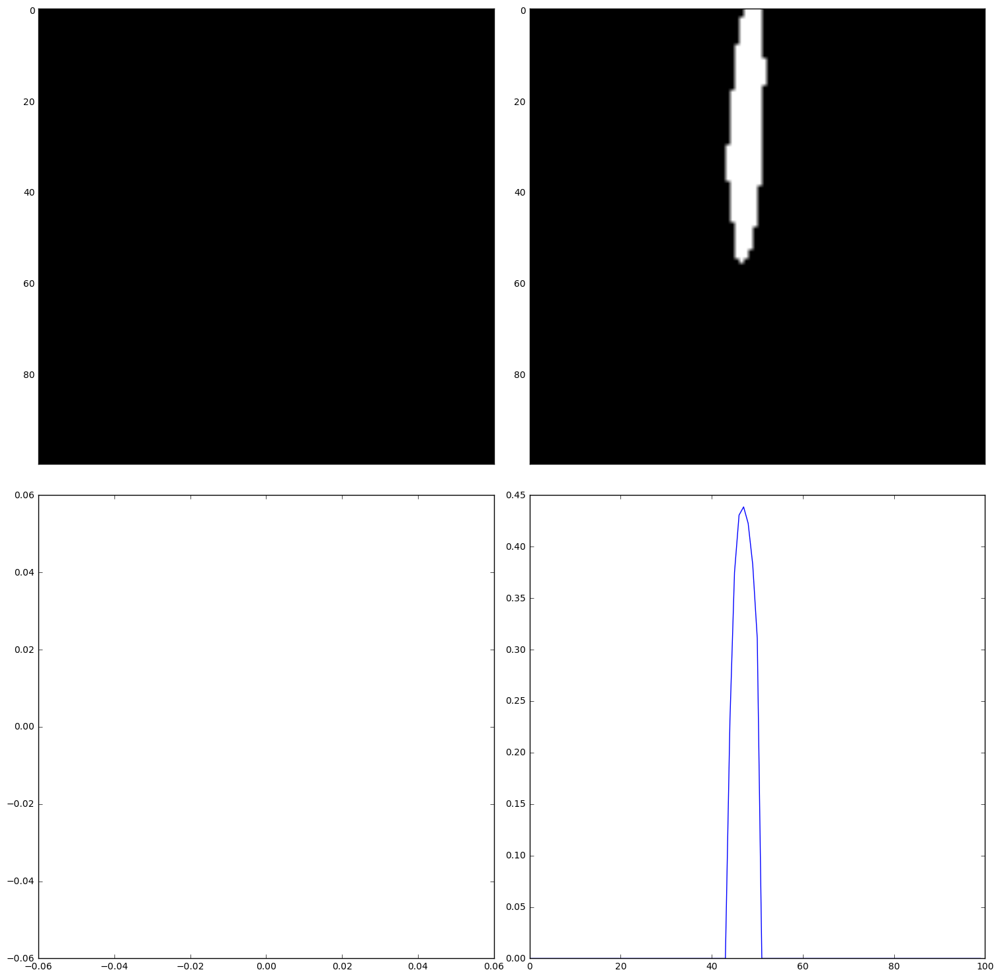

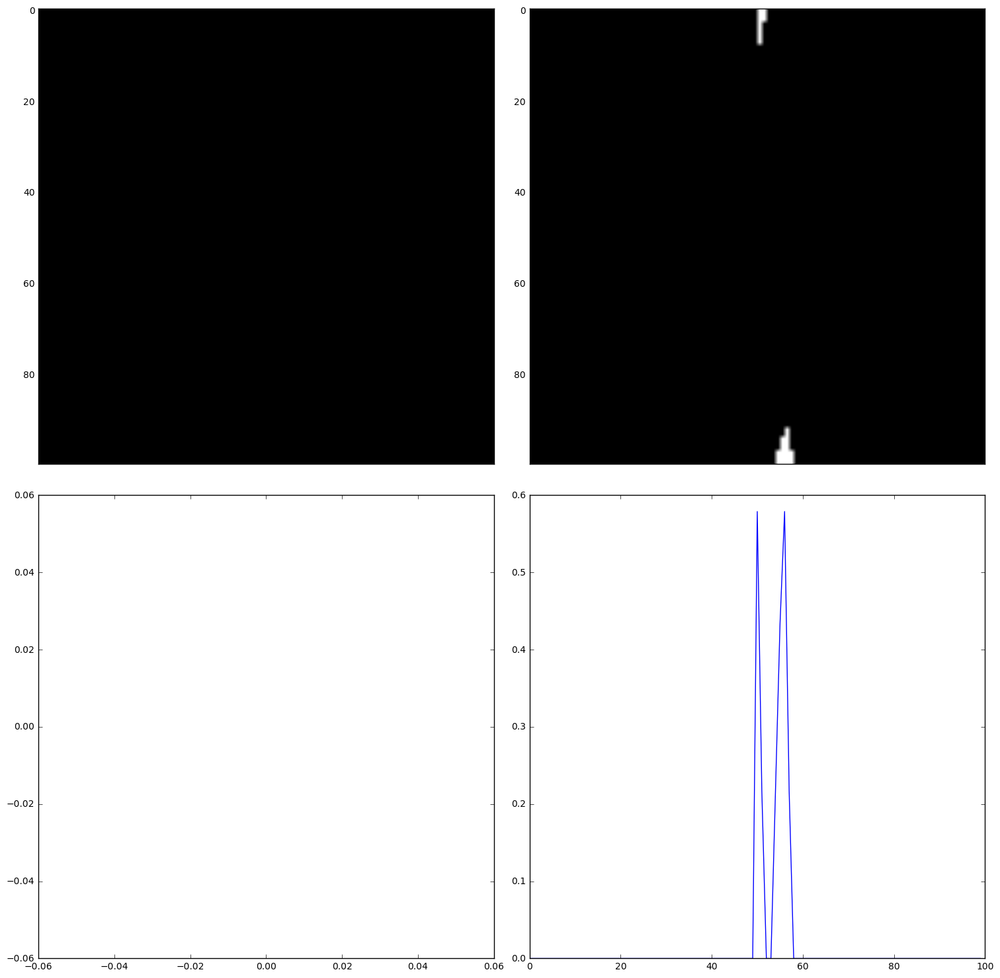

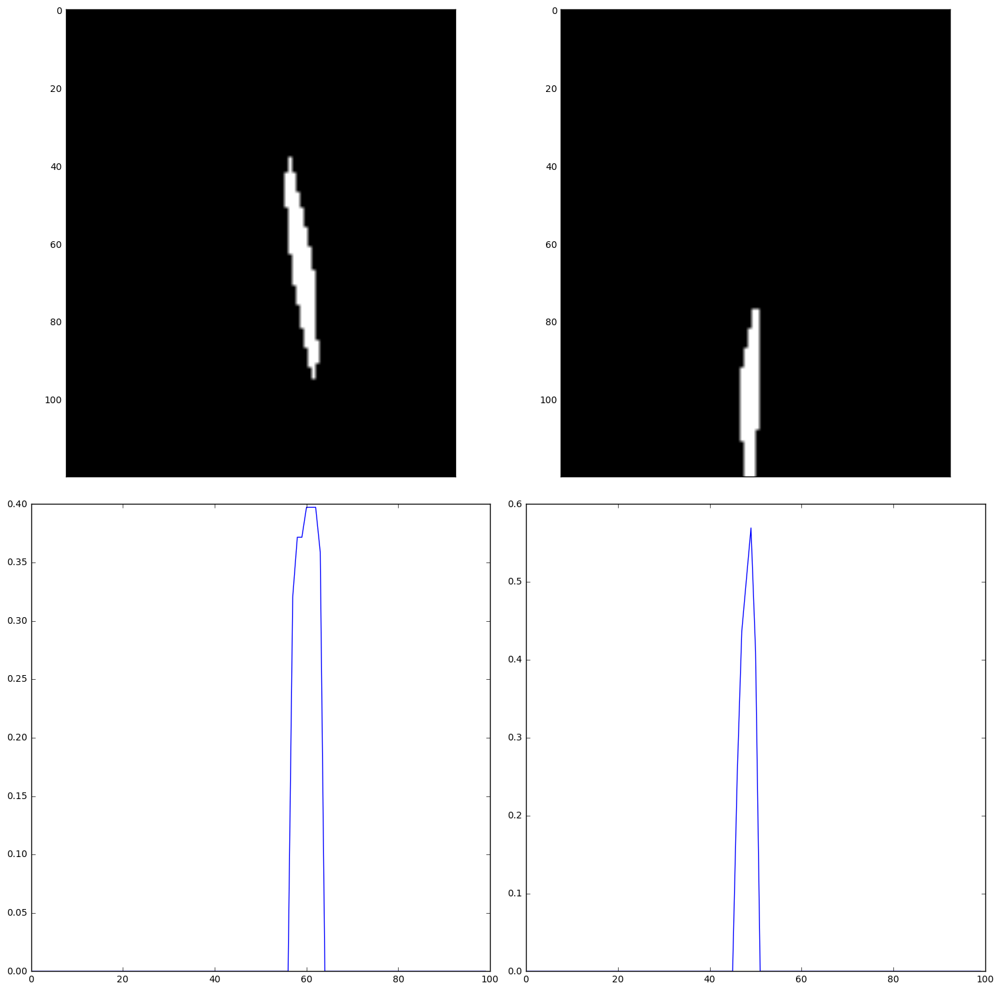

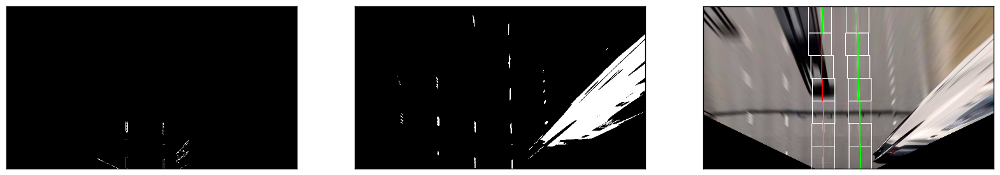

In [15]:
org = udimg1
und = undistort(org, udmtx, uddist)
warp, M = unwarp(und, udmtx, uddist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

y, x = warp.shape[:2]
sx[:,:400] = 0
sx[:,800:] = 0
sx[:500,:] = 0

pairs = get_peaks(sx, x//2, False)
line_imgs, centroids = draw_lane_lines(sx, pairs[0][0], pairs[0][1], warp, True)

We obtain equally good results for the curved lanes lines:

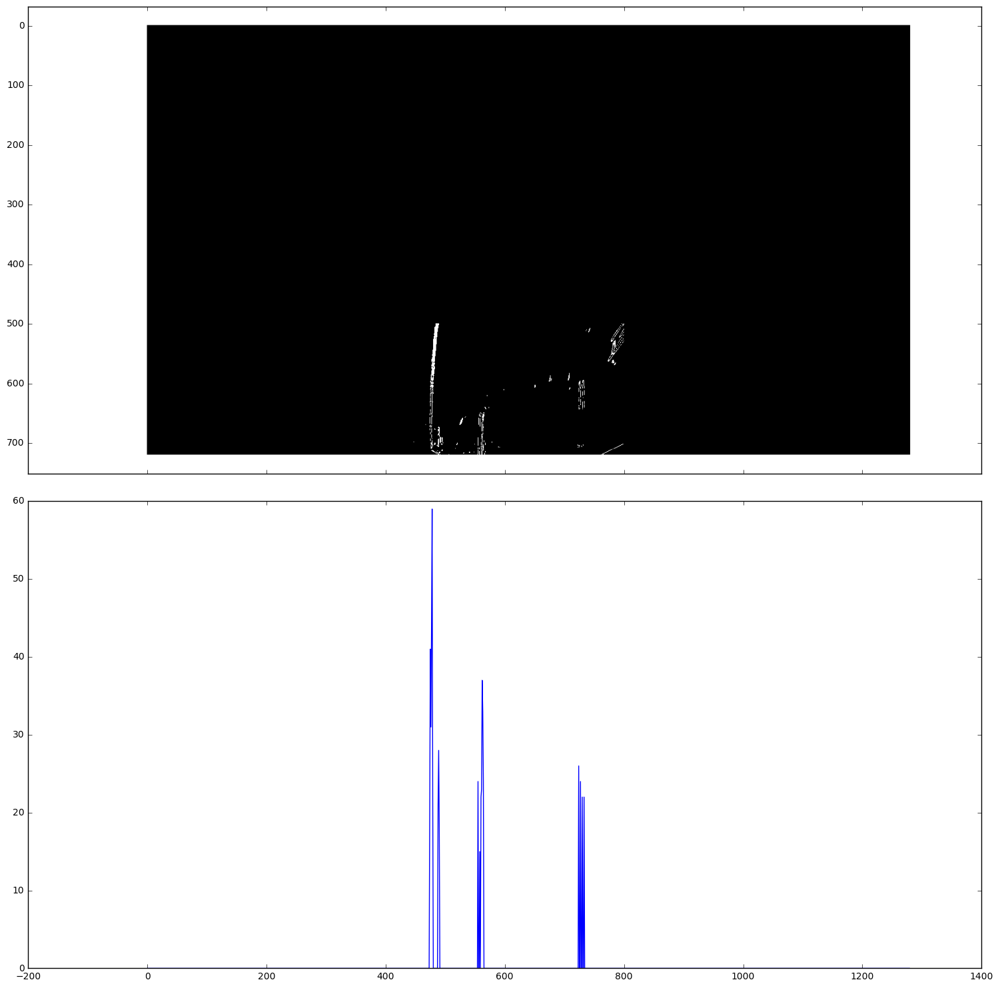

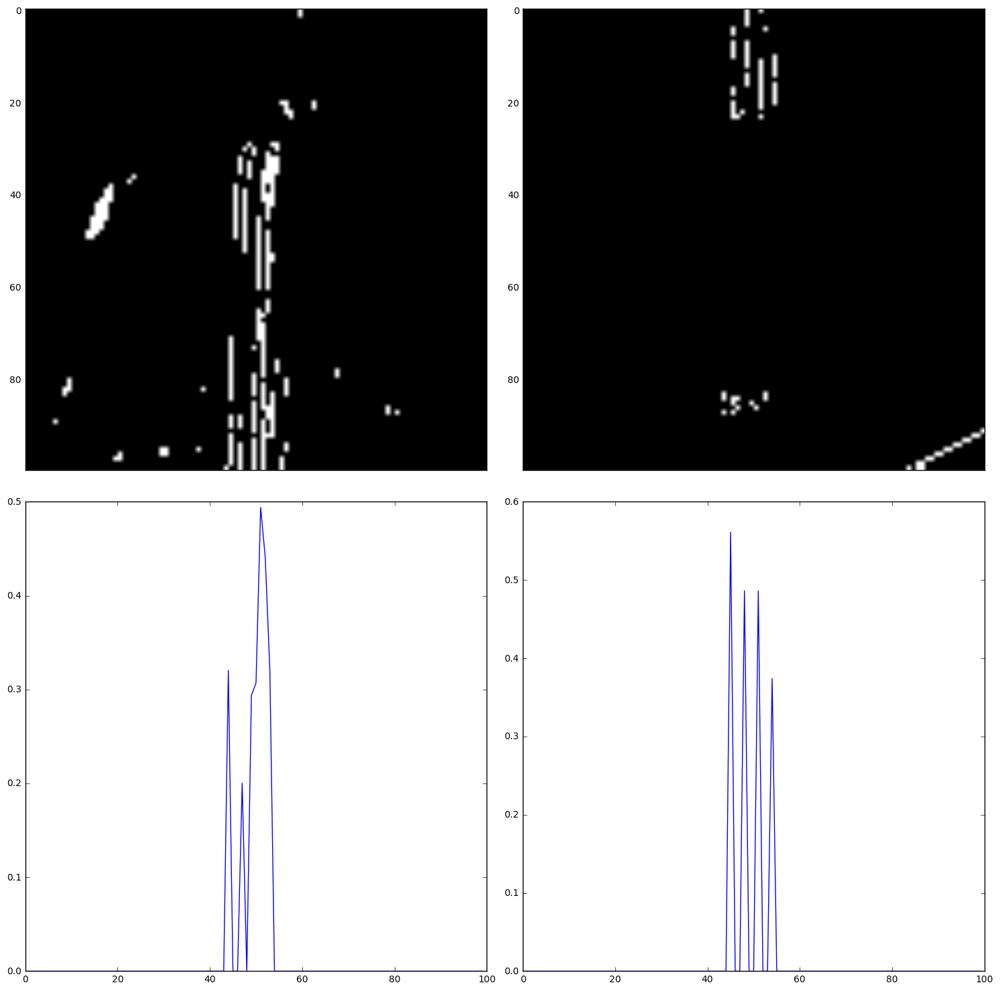

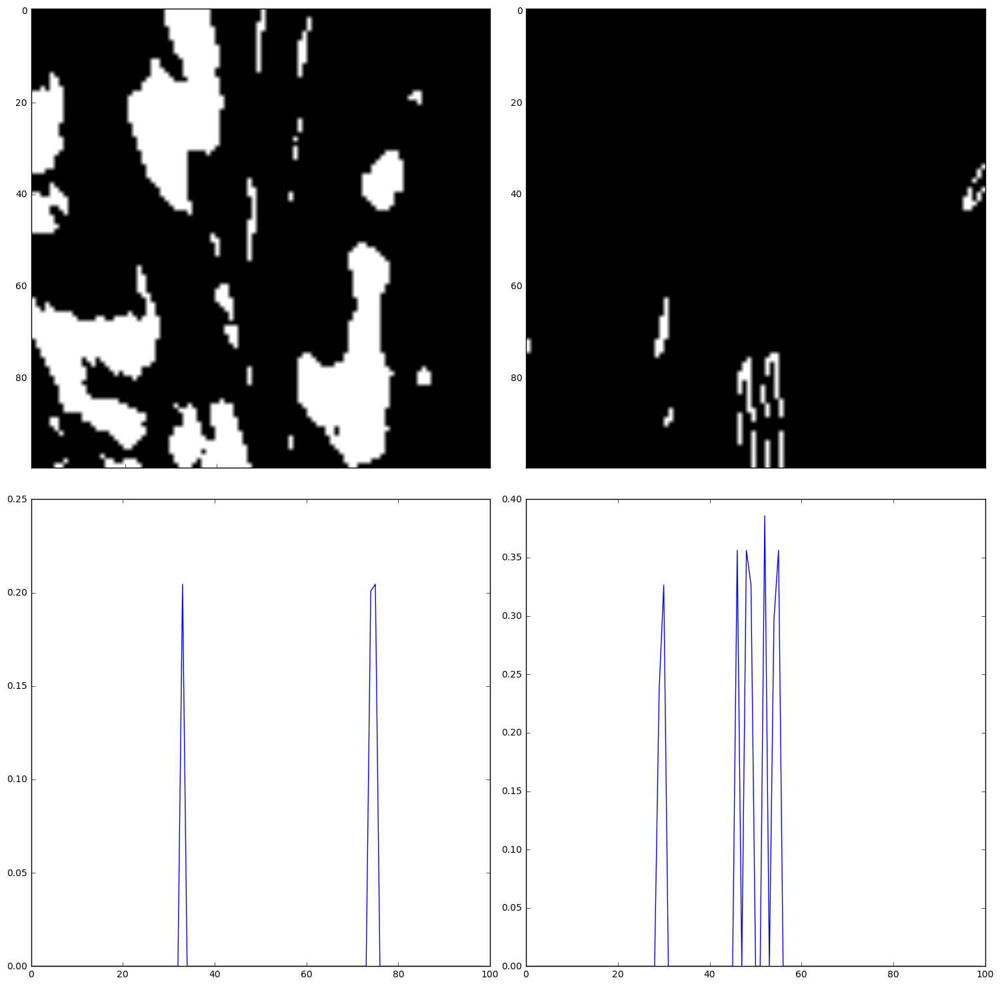

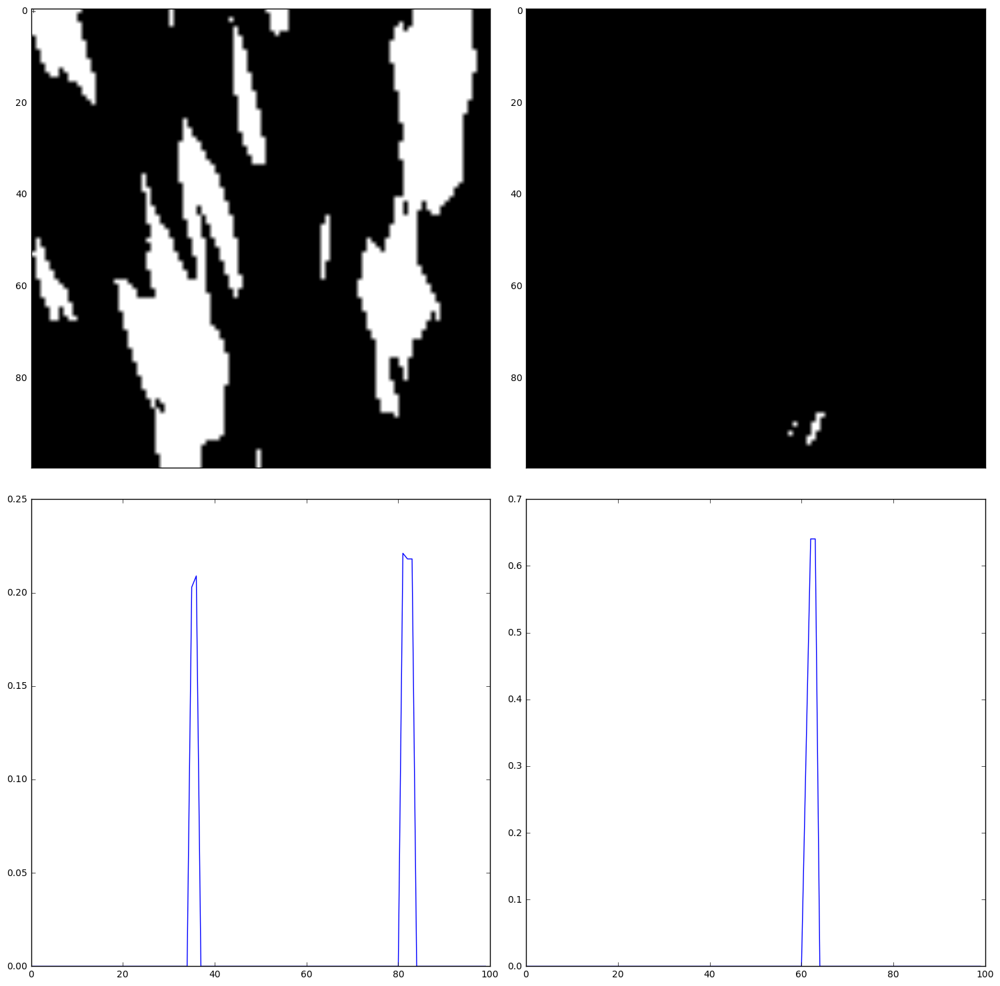

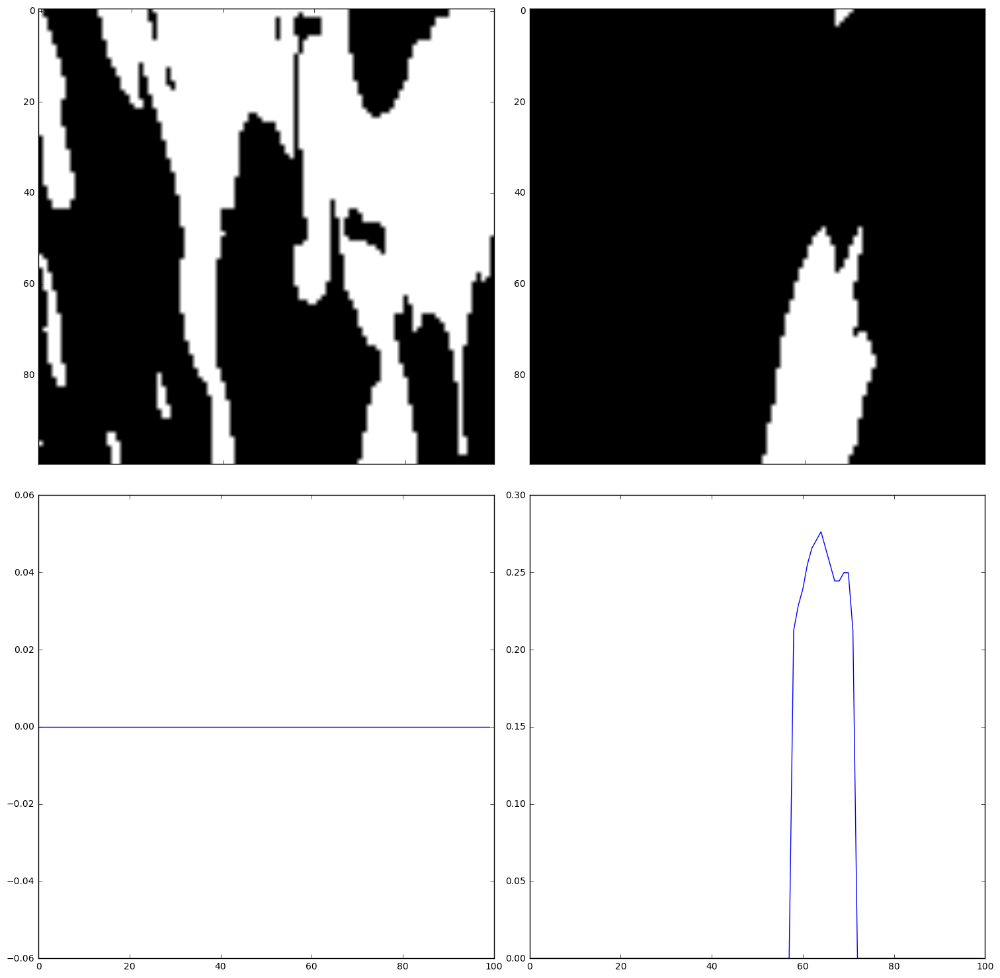

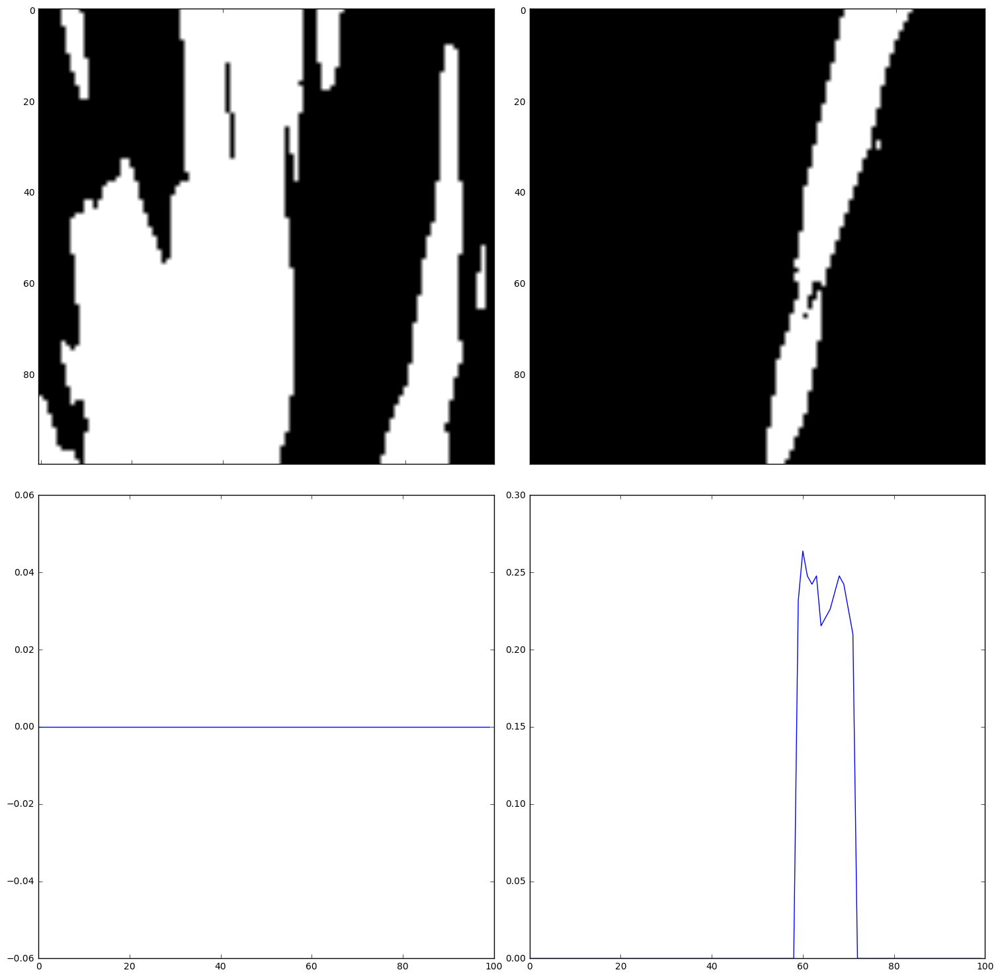

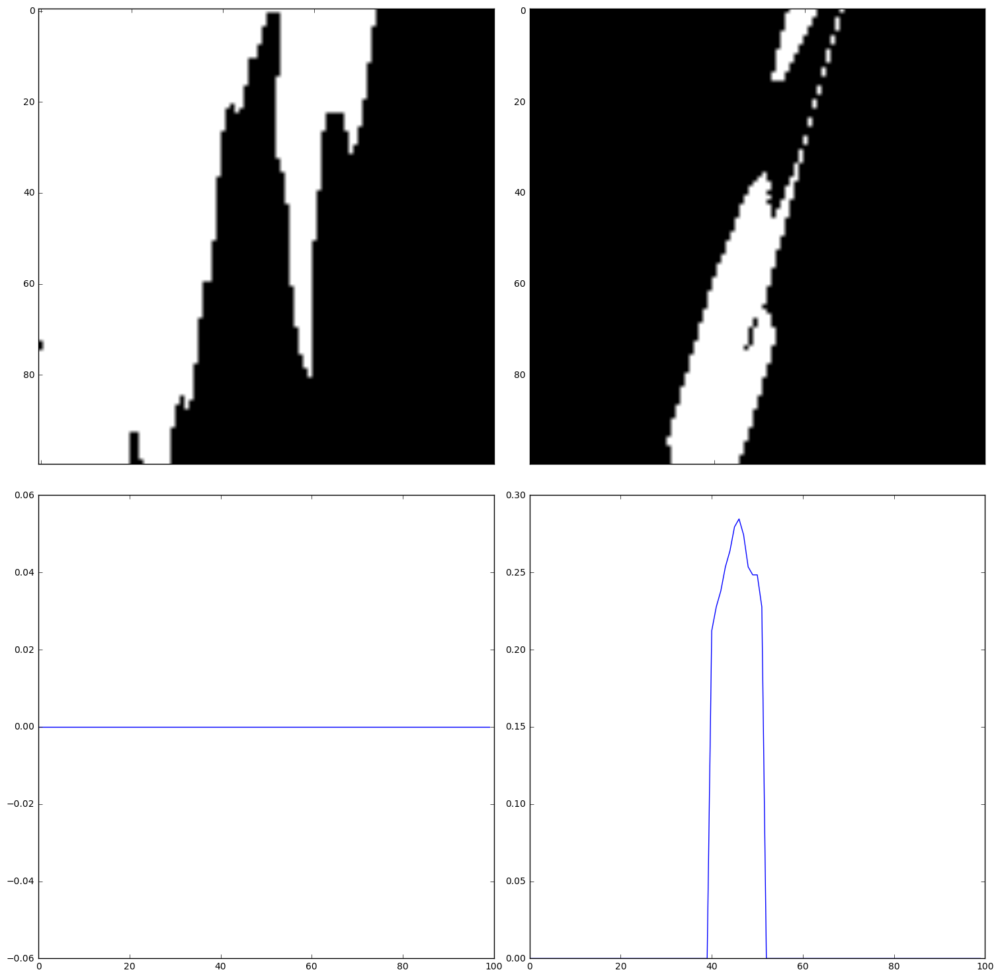

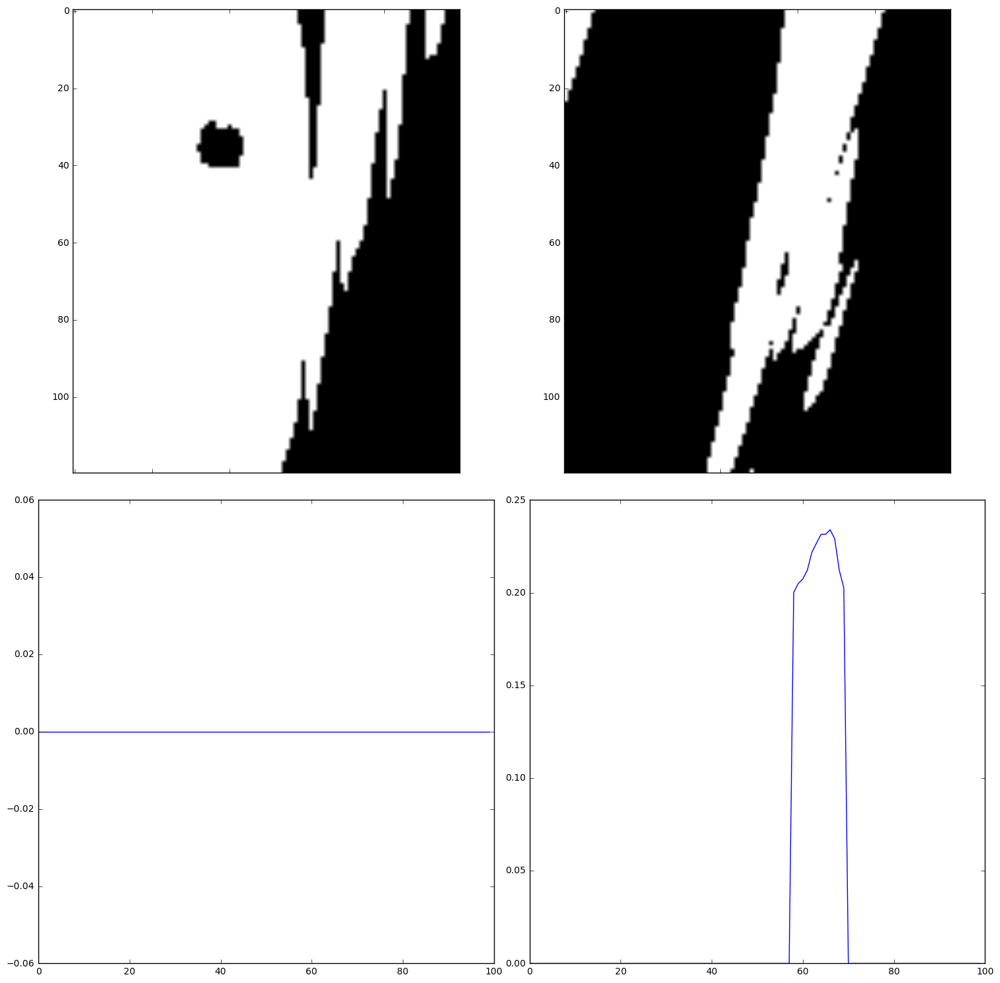

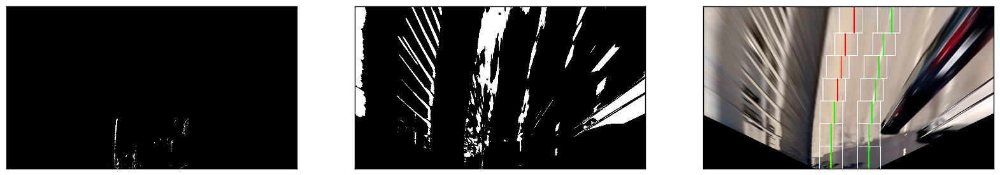

In [16]:
org = udimg2
und = undistort(org, udmtx, uddist)
warp, M = unwarp(und, udmtx, uddist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

y, x = warp.shape[:2]
sx[:,:400] = 0
sx[:,800:] = 0
sx[:500,:] = 0

pairs = get_peaks(sx, x//2)
line_imgs, centroids = draw_lane_lines(sx, pairs[0][0], pairs[0][1], warp, True)

**5. Describe how (and identify where in your code) you calculated the radius of curvature of the lane and the position of the vehicle with respect to center.**

Given the code above, I looked for the centroids of each of the boxes. And then with this, I calculated a polynomial and the curvature of the lines:

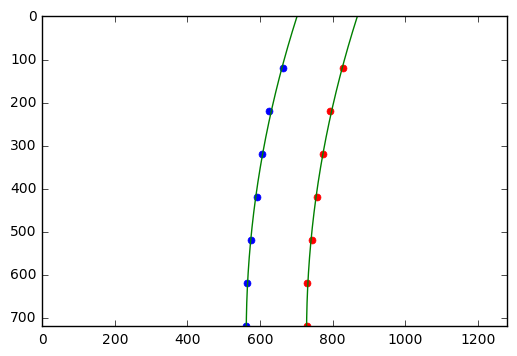

In [17]:
###### plot lanes
data = np.array(centroids)
l = data[:,0]
r = data[:,1]
y = data[:,2]

ypoints = np.arange(720)
coefsl = poly.polyfit(y, l, 2)
ffitl = poly.polyval(ypoints, coefsl)

coefsr = poly.polyfit(y, r, 2)
ffitr = poly.polyval(ypoints, coefsr)

plt.plot(l, y, 'b.', markersize=10)
plt.plot(r, y, 'r.', markersize=10)

plt.xlim(0, 1280)
plt.ylim(0, 720)
plt.plot(ffitl, ypoints, color='green', linewidth=1)
plt.plot(ffitr, ypoints, color='green', linewidth=1)
plt.gca().invert_yaxis() # to visualize as we do the images
plt.show()

Given this polynomial finding the curvature is accomplished as follows:

In [18]:
# Define conversions in x and y from pixels space to meters
y_eval = np.max(y)//2
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meteres per pixel in x dimension

left_fit_cr = np.polyfit(y*ym_per_pix, l*xm_per_pix, 2)
right_fit_cr = np.polyfit(y*ym_per_pix, r*xm_per_pix, 2)

left_curverad = ((1 + (2*left_fit_cr[0]*y_eval + left_fit_cr[1])**2)**1.5) \
                             /np.absolute(2*left_fit_cr[0])

right_curverad = ((1 + (2*right_fit_cr[0]*y_eval + right_fit_cr[1])**2)**1.5) \
                                /np.absolute(2*right_fit_cr[0])

average_curvature = np.mean((left_curverad, right_curverad))
curvature_info = "curvature = {:.0f}m".format(average_curvature)
print(curvature_info)

curvature = 911m


The position is provided in a similar fashion:

In [19]:
left_bottom_x = ffitl[-1]
right_bottom_x = ffitr[-1]
lane_center = (left_bottom_x + right_bottom_x)/2.0
car_center = x/2.0
shift = (car_center - lane_center) * xm_per_pix
if shift > 0:
    # right
    shift_info = '     {:.2f}m ---|'.format(abs(shift))
else:
    # left
    shift_info =  '|--- {:.2f}m     '.format(abs(shift))
print(shift_info)      

|--- 0.03m     


**6. Provide an example image of your result plotted back down onto the road such that the lane area is identified clearly.**

Given the last image, we can get the inverse matrix to bring the image back to its original perspective. Let's add a couple of functions to get that accomplished:

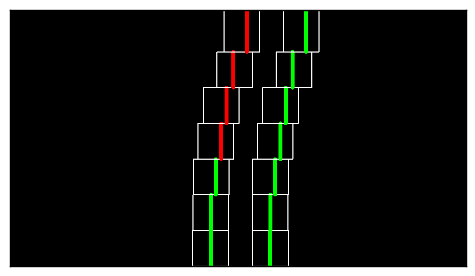

In [20]:
short, binary, color, color_dark = line_imgs
plot_imgs([color_dark])

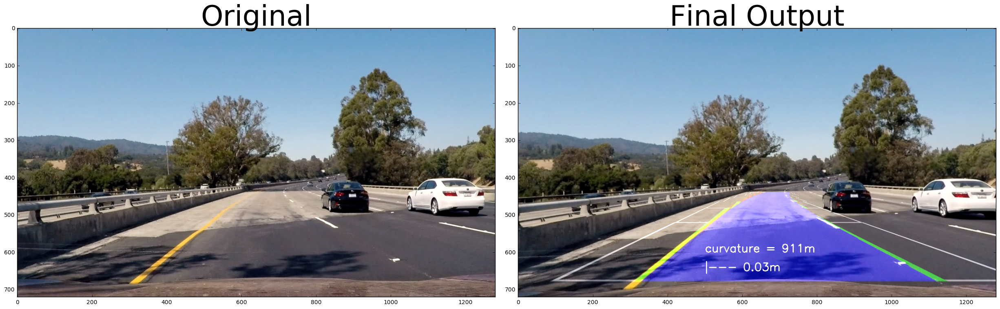

In [21]:
pts_left = np.array([np.transpose(np.vstack([ffitl, ypoints]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([ffitr, ypoints])))])
pts = np.hstack((pts_left, pts_right))

# polyarea = np.zeros_like(line_imgs[-1])
# Draw the lane onto the warped blank image
cv2.fillPoly(color_dark, np.int_([pts]), (0,0,255))

img_size = (und.shape[1], und.shape[0])    
Minv = get_perspective(img_size, inv=True)
# result = warp_back(und, warp, ffitl, ffitr)
overlay = cv2.warpPerspective(line_imgs[-1], Minv, img_size)

# Combine the result with the original image
result = cv2.addWeighted(und, 1, overlay, 0.5, 0)

font = cv2.FONT_HERSHEY_SIMPLEX
cv2.putText(result, curvature_info, (500,600), font, 1,(255,255,255),2)
cv2.putText(result, shift_info, (500,650), font, 1,(255,255,255),2)

plot_side_by_side(udimg2, "Original", result, 'Final Output')

# Pipeline (video)

**1. Provide a link to your final video output. Your pipeline should perform reasonably well on the entire project video (wobbly lines are ok but no catastrophic failures that would cause the car to drive off the road!).**

The following is the result for the project video:

[![Alt text](https://img.youtube.com/vi/70W4hzPcW_M/0.jpg)](https://youtu.be/70W4hzPcW_M)

# Discussion

**1. Briefly discuss any problems / issues you faced in your implementation of this project. Where will your pipeline likely fail? What could you do to make it more robust?**

Implementation took a very long time, so the major issue was the time allocated to this project. There are a possible issue with this implementation and the pipeline would likely fail in places with very sharp curves. The way this algorithm could be made more robust is to implement some Bayesian filter such a Particle Filters or Kalman Filters to track the lane lines. This would definitely improve the pipeline and avoid the jittery behavior.

# Extra work

I didn't stop here, I recorder my own videos driving in Dallas, TX. This presented a higher challenge for multiple reason. First, the cameras were completely different, also, the road markings are slightly changed and the colors thresholds didn't match up. In any case, I present you the results on my own implementation.

# Own Camera Calibration

I went ahead and printed my own checkboard in order to calibrate my cell phone camera:

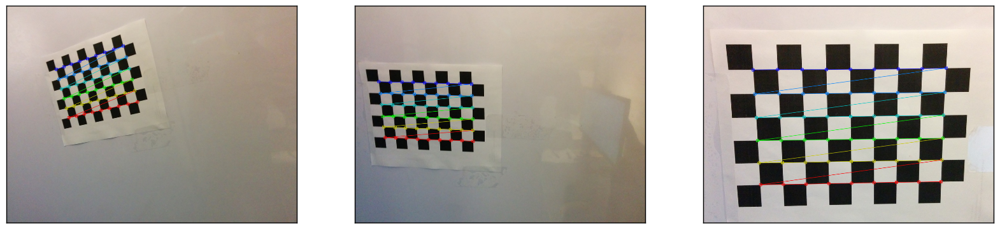

In [22]:
myobjpoints, myimgpoints, myimgs = get_calibration_coef('my_cal/calibration*.jpg', plot=True)
plot_imgs(myimgs[0:3])

Then undistorted my own images:

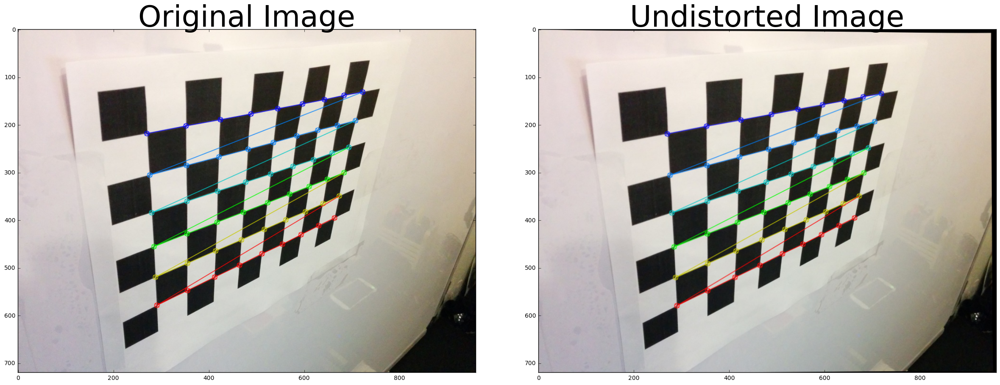

In [23]:
myimg = myimgs[-3]
myundistorted, mymtx, mydist = cal_undistort(myimg, myobjpoints, myimgpoints)
plot_side_by_side(myimg, 'Original Image', myundistorted, 'Undistorted Image')

# Own Images Result

I collected a couple of difficult images to test out how robust my implementation was:

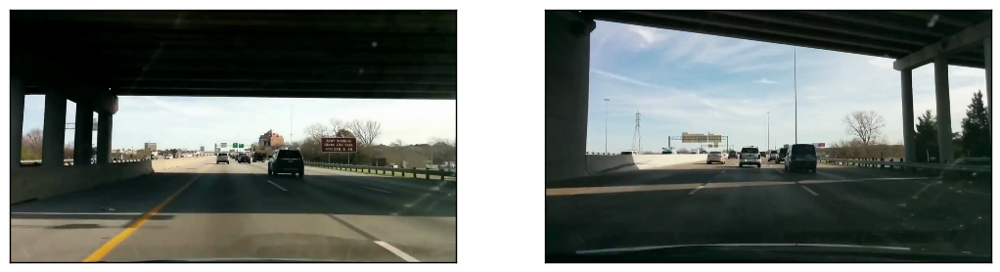

In [24]:
myimg1 = imread('my_images/vlcsnap-00001.png')
myimg2 = imread('my_images/vlcsnap-00006.png')

plot_imgs([myimg1, myimg2])

Worked the pipeline by creating a bird's eye view:

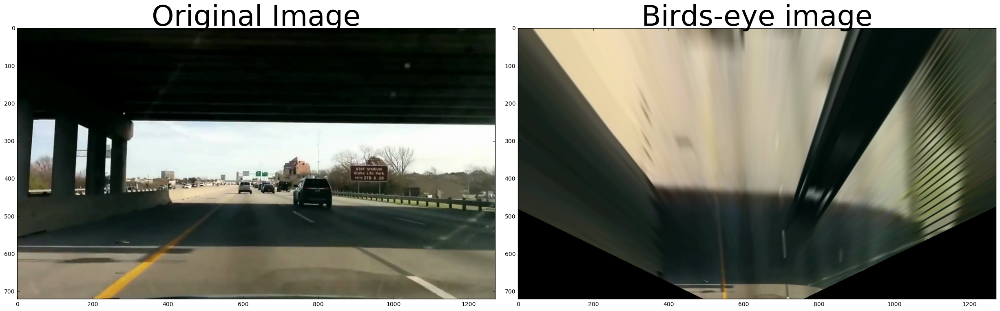

In [25]:
org = myimg1
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, mymtx, mydist)
plot_side_by_side(org, 'Original Image', warp, 'Birds-eye image')

Then, I obtained the binary images from them:

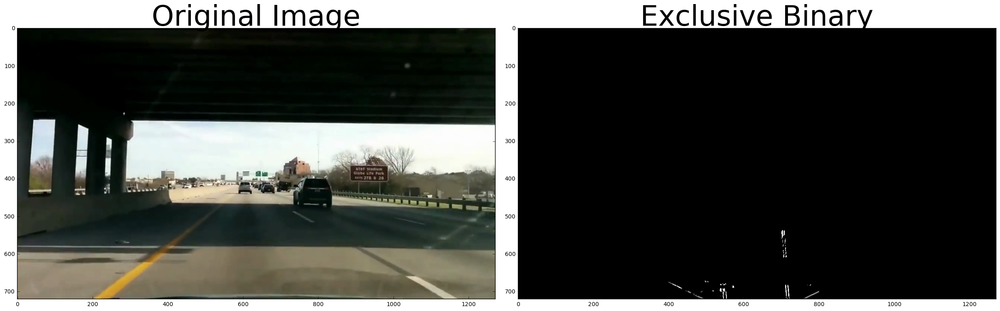

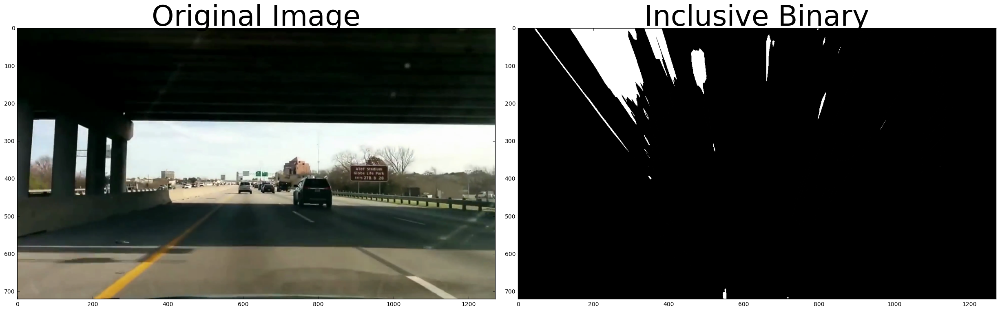

In [26]:
org = myimg1
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, mymtx, mydist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))
binary = detect_binary_lines(warp)

y, x = warp.shape[:2]
sx[:,:400] = 0
sx[:,800:] = 0
sx[:500,:] = 0

plot_side_by_side(org, 'Original Image', sx, 'Exclusive Binary')
plot_side_by_side(org, 'Original Image', binary, 'Inclusive Binary')

Then, used the same window method as before:

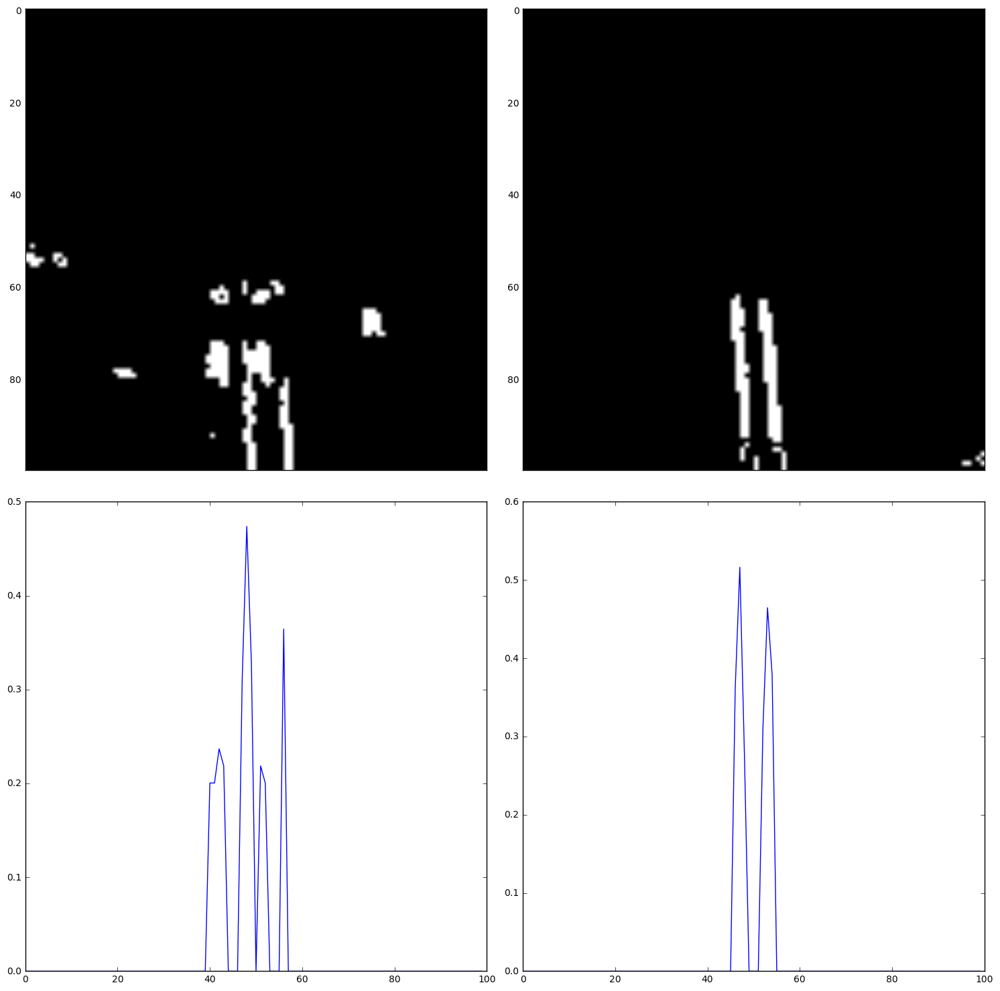

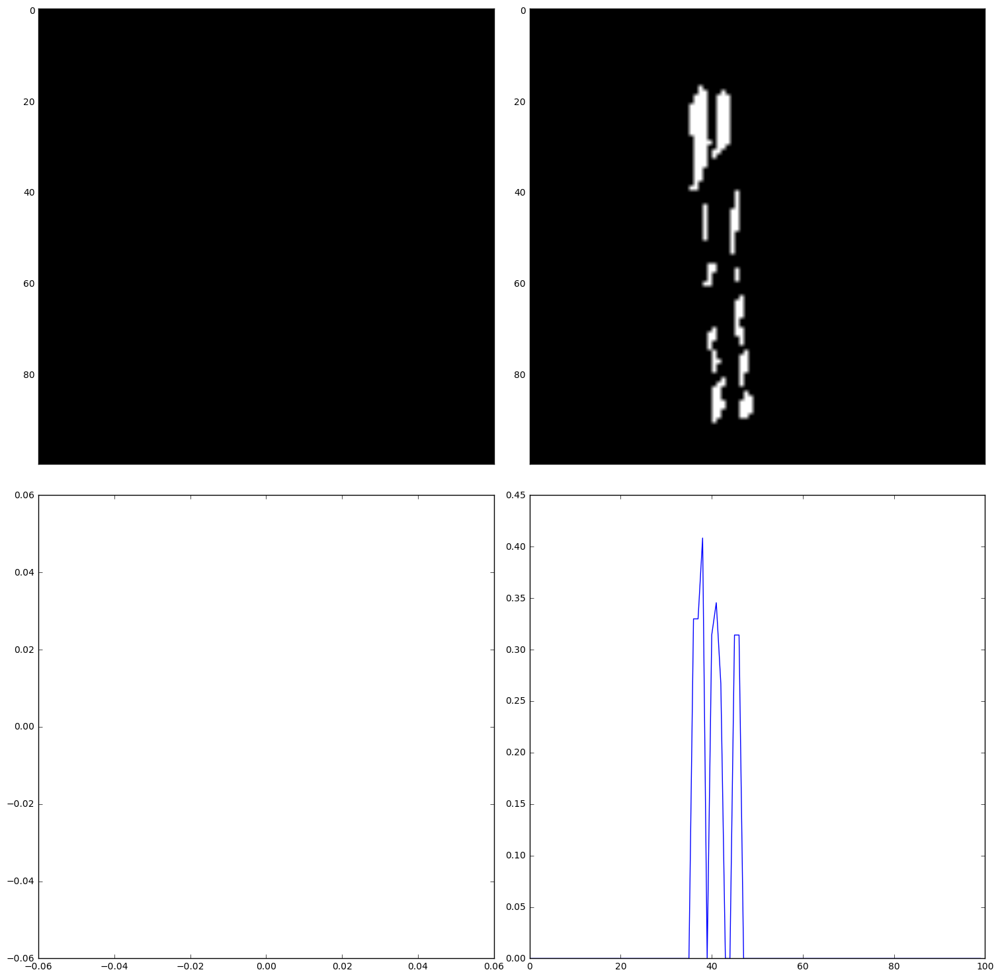

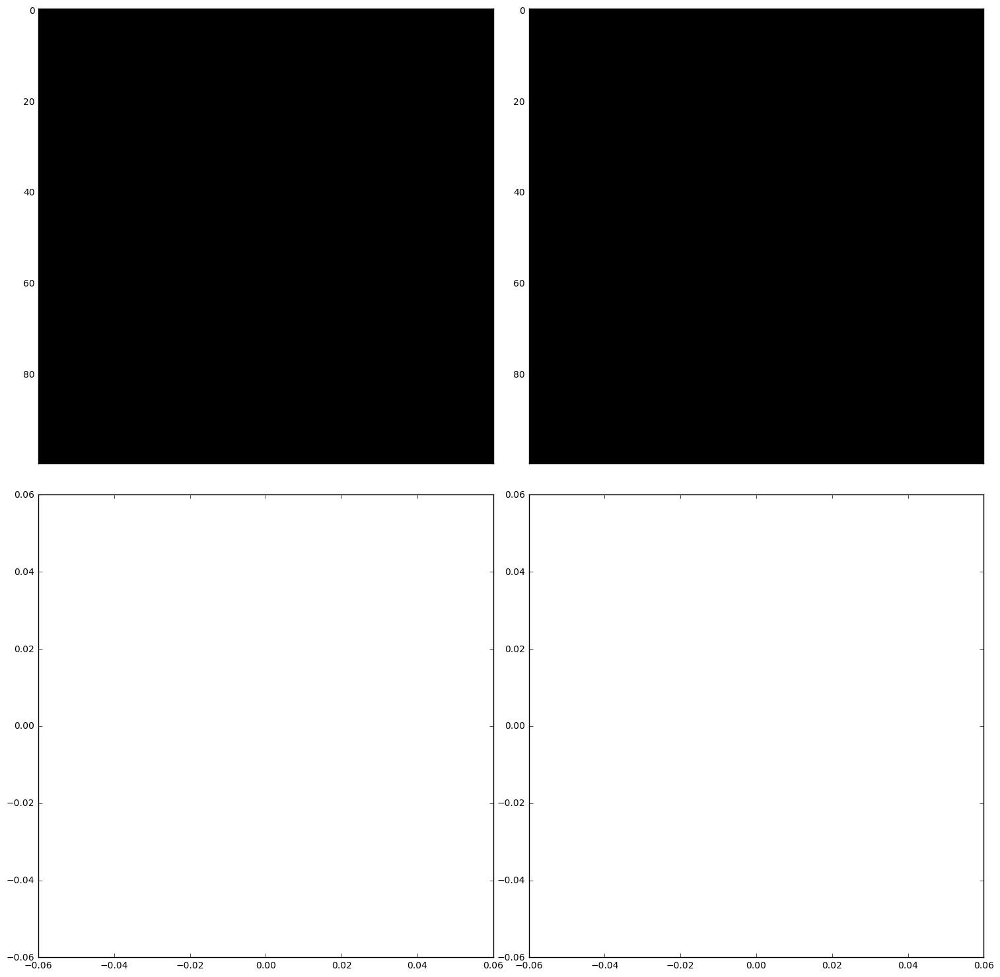

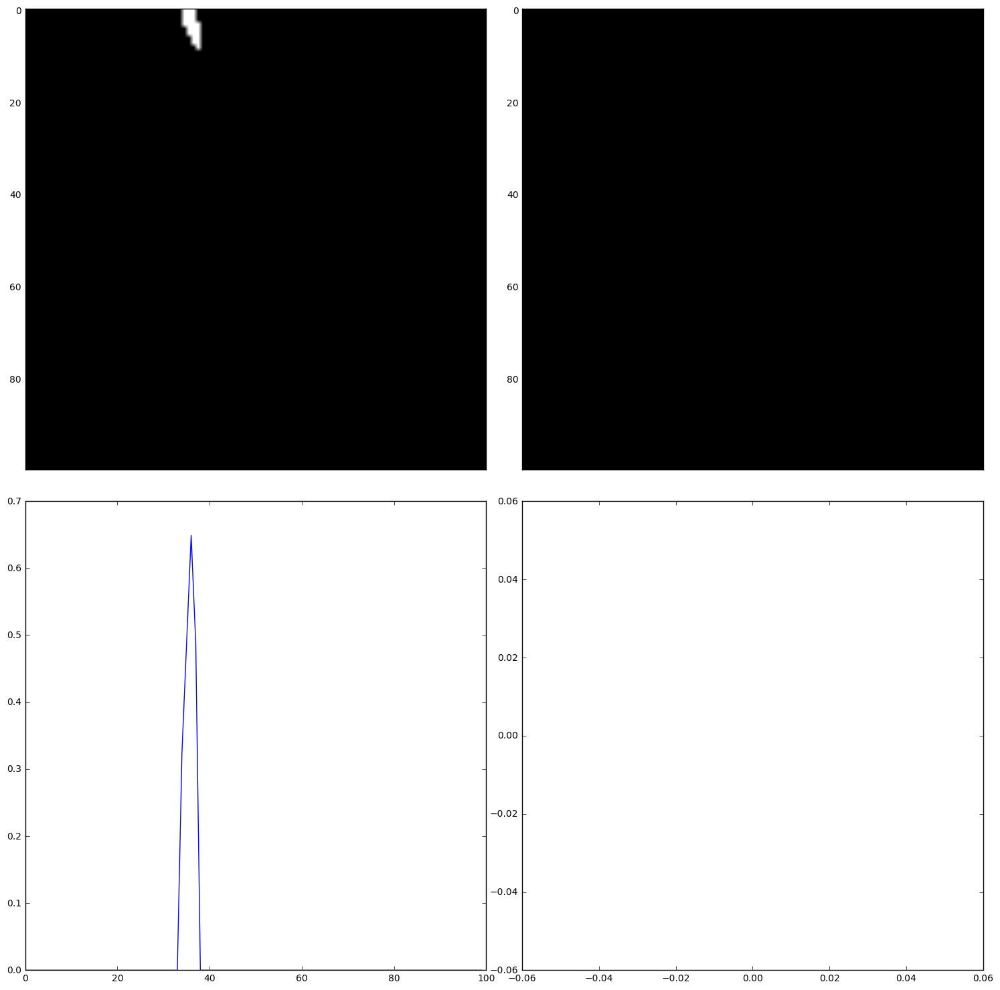

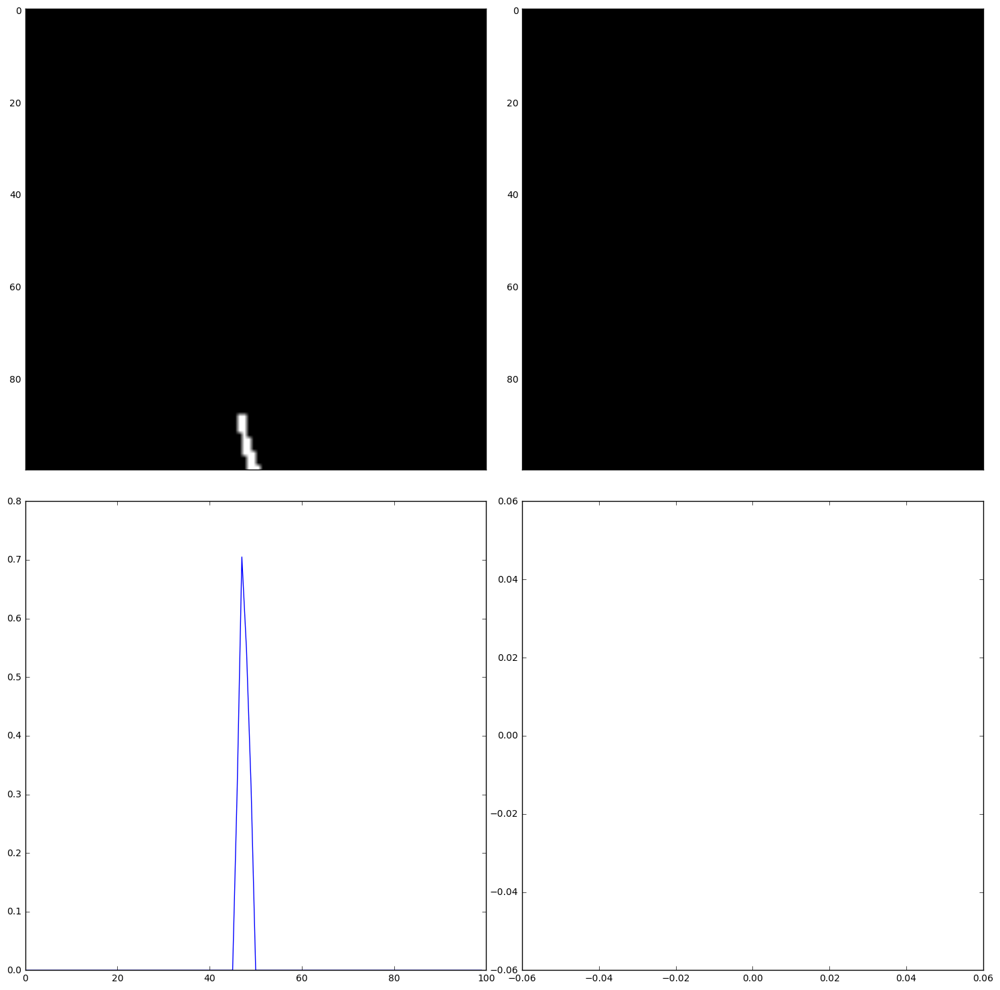

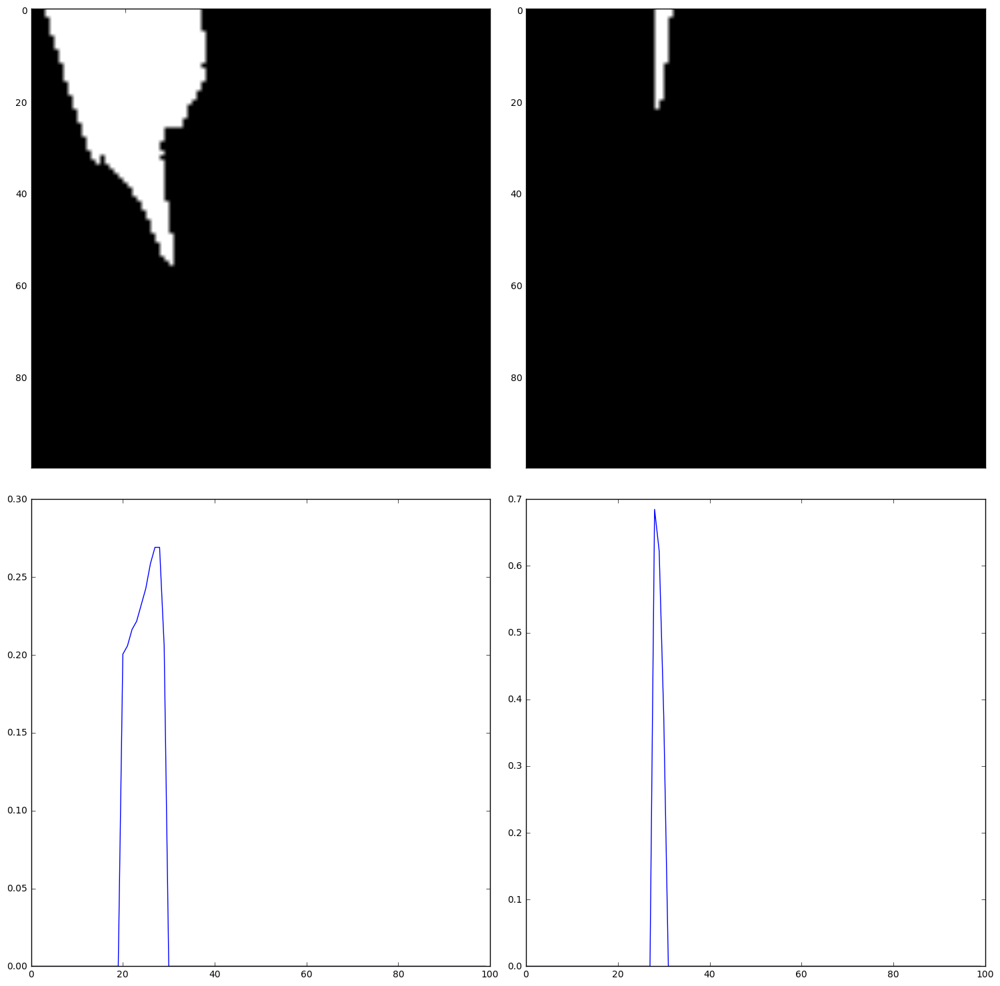

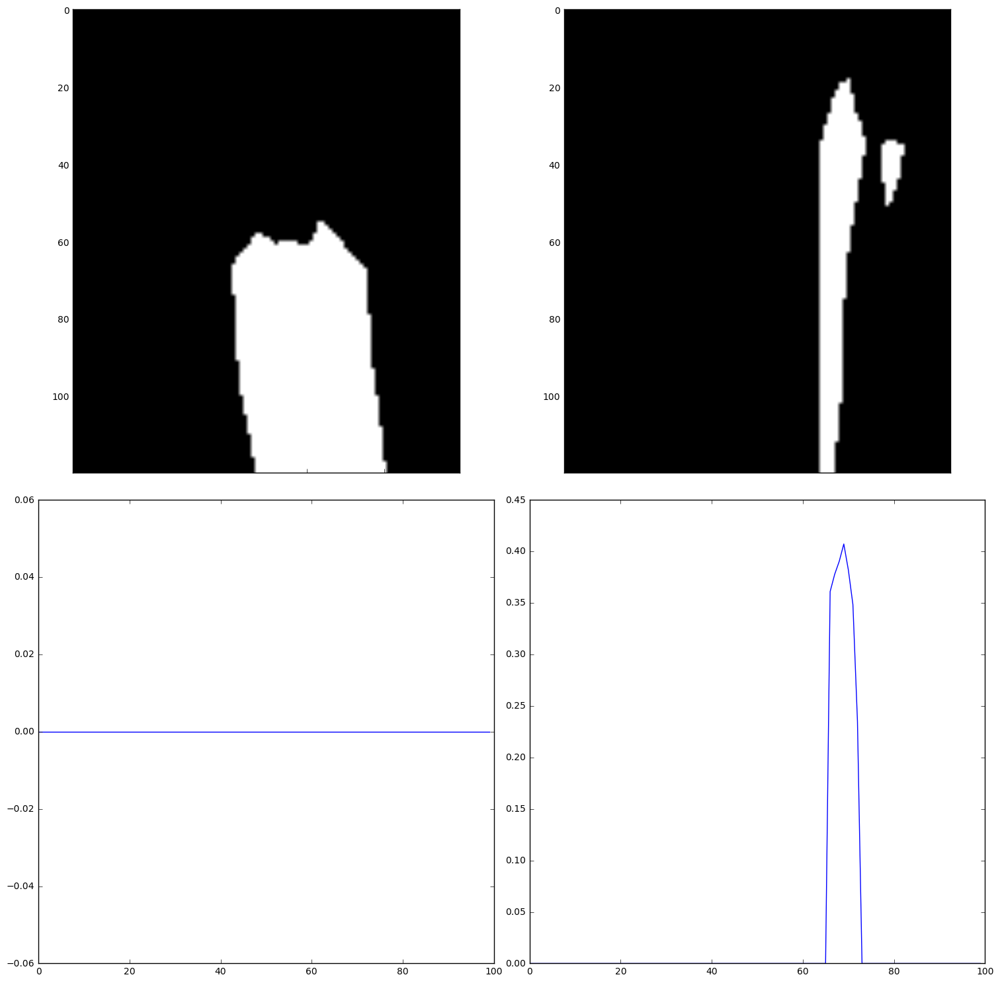

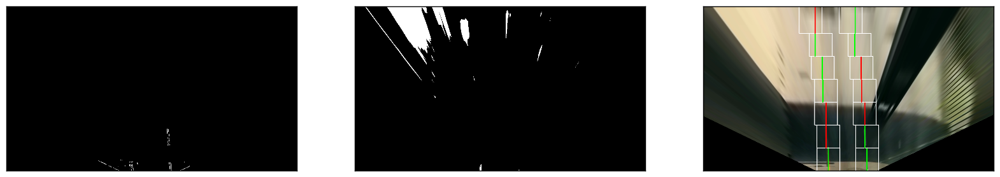

In [27]:
org = myimg1
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, mymtx, mydist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

y, x = warp.shape[:2]
sx[:,:400] = 0
sx[:,800:] = 0
sx[:500,:] = 0

pairs = get_peaks(sx, x//2, False)
line_imgs, centroids = draw_lane_lines(sx, pairs[0][0], pairs[0][1], warp, True)

Then detected the points:

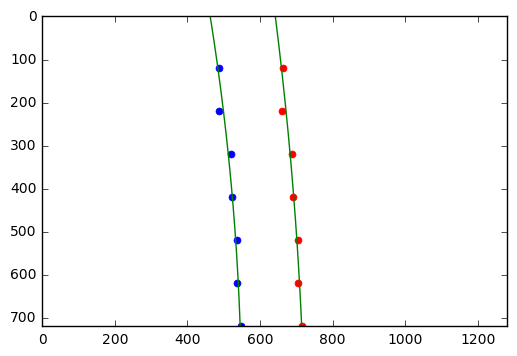

In [28]:
###### plot lanes
data = np.array(centroids)
l = data[:,0]
r = data[:,1]
y = data[:,2]

ypoints = np.arange(720)
coefsl = poly.polyfit(y, l, 2)
ffitl = poly.polyval(ypoints, coefsl)

coefsr = poly.polyfit(y, r, 2)
ffitr = poly.polyval(ypoints, coefsr)

plt.plot(l, y, 'b.', markersize=10)
plt.plot(r, y, 'r.', markersize=10)

plt.xlim(0, 1280)
plt.ylim(0, 720)
plt.plot(ffitl, ypoints, color='green', linewidth=1)
plt.plot(ffitr, ypoints, color='green', linewidth=1)
plt.gca().invert_yaxis() # to visualize as we do the images
plt.show()

Calculated the curvature:

In [29]:
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meteres per pixel in x dimension

left_fit_cr = np.polyfit(y*ym_per_pix, l*xm_per_pix, 2)
right_fit_cr = np.polyfit(y*ym_per_pix, r*xm_per_pix, 2)

left_curverad = ((1 + (2*left_fit_cr[0]*y_eval + left_fit_cr[1])**2)**1.5) \
                             /np.absolute(2*left_fit_cr[0])

right_curverad = ((1 + (2*right_fit_cr[0]*y_eval + right_fit_cr[1])**2)**1.5) \
                                /np.absolute(2*right_fit_cr[0])

average_curvature = np.mean((left_curverad, right_curverad))
curvature_info = "curvature = {:.0f}m".format(average_curvature)
print(curvature_info)

curvature = 2113m


And the shift from the center:

In [30]:
left_bottom_x = ffitl[-1]
right_bottom_x = ffitr[-1]
lane_center = (left_bottom_x + right_bottom_x)/2.0
car_center = x/2.0
shift = (car_center - lane_center) * xm_per_pix
if shift > 0:
    # right
    shift_info = '     {:.2f}m ---|'.format(abs(shift))
else:
    # left
    shift_info =  '|--- {:.2f}m     '.format(abs(shift))
print(shift_info)

     0.03m ---|


Finally I used the created mask:

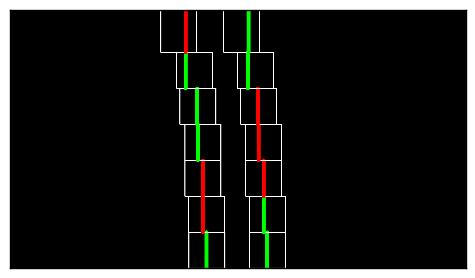

In [31]:
short, binary, color, color_dark = line_imgs
plot_imgs([color_dark])

To put it in the original image:

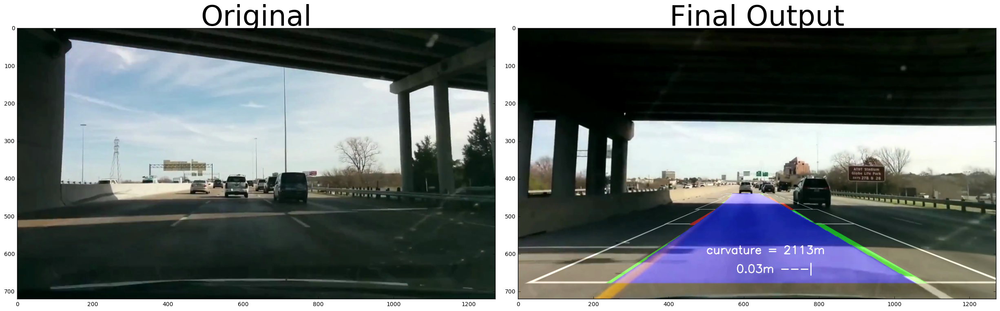

In [32]:
pts_left = np.array([np.transpose(np.vstack([ffitl, ypoints]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([ffitr, ypoints])))])
pts = np.hstack((pts_left, pts_right))

# polyarea = np.zeros_like(line_imgs[-1])
# Draw the lane onto the warped blank image
cv2.fillPoly(color_dark, np.int_([pts]), (0,0,255))

img_size = (und.shape[1], und.shape[0])    
Minv = get_perspective(img_size, inv=True)
# result = warp_back(und, warp, ffitl, ffitr)
overlay = cv2.warpPerspective(line_imgs[-1], Minv, img_size)

# Combine the result with the original image
result = cv2.addWeighted(und, 1, overlay, 0.5, 0)

font = cv2.FONT_HERSHEY_SIMPLEX
cv2.putText(result, curvature_info, (500,600), font, 1,(255,255,255),2)
cv2.putText(result, shift_info, (500,650), font, 1,(255,255,255),2)

plot_side_by_side(myimg2, "Original", result, 'Final Output')

# Own Videos Result

These are the video results:

[![Alt text](https://img.youtube.com/vi/nd_C-uVPFfk/0.jpg)](https://youtu.be/nd_C-uVPFfk)

# Further Work and Improvements

As I mentioned before, the most important improve would be to use a Bayesian filter to remove the noise from out observations. In the next project, I'll to integrate this work into a more advanced pipeline.

# References

* Udacity lectures were instrumental, obviously.
* This paper seemed to be one of the best I reviewed: http://journals.sagepub.com/doi/pdf/10.1177/0954407014567719
* Lots of internet queries, thanks to the WWW!